# Imports

In [6]:
# import libraries
import spacy
nlp = spacy.load('en_core_web_sm')

import plotly
import plotly.offline as pyo
from plotly.offline import init_notebook_mode
from plotly.graph_objs import *
import cufflinks as cf
cf.go_offline()
cf.set_config_file(theme='white')
from sklearn.preprocessing import StandardScaler
import pandas as pd
import numpy as np
import re

import nltk
import os
import sys
import re
import bs4
from bs4 import BeautifulSoup
from spacy.lang.en.stop_words import STOP_WORDS
import spacy
import string

from collections import Counter
from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from nltk.tokenize import word_tokenize
import string

from sklearn.feature_extraction.text import CountVectorizer 
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import NMF
from sklearn.metrics.pairwise import cosine_similarity

In [7]:
from nltk import FreqDist
import gensim
from gensim import corpora
import warnings
warnings.filterwarnings("ignore")
#libraries for visualization
import matplotlib.pyplot as plt
# plt.style.use('classic')
import seaborn as sns
import pyLDAvis
import gensim
%matplotlib inline
from gensim import corpora
import pyLDAvis.gensim_models as gensimvis
from spacy.lang.en.stop_words import STOP_WORDS
from sklearn.decomposition import PCA

In [8]:
# import libraries
import nltk
from nltk import FreqDist

import numpy as np
import pandas as pd

import re
import spacy

import gensim
from gensim import corpora
import warnings
warnings.filterwarnings("ignore")
#libraries for visualization
import matplotlib.pyplot as plt
# plt.style.use('classic')
import seaborn as sns
import pyLDAvis
import gensim
%matplotlib inline
from gensim import corpora
import pyLDAvis.gensim_models as gensimvis

In [9]:
# gensim
from gensim import corpora, models, similarities, matutils

# sklearn
from sklearn import datasets
from sklearn.feature_extraction.text import CountVectorizer

# logging for gensim (set to INFO)

## Reading The Data

In [23]:

df = pd.read_csv("/Users/snouto/Downloads/Amazon_Unlocked_Mobile.csv")

df.head()

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,5,Very pleased,0.0
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0


In [24]:
!pip install demoji

In [25]:
import demoji

In [26]:
#!pip install demoji
### Convert emoji into text
def convert_icons(review):
    import demoji
    try:
        results = demoji.findall(review)
        for icon,feeling in results.items():
            review = review.replace(icon,feeling)
    except:
        pass
    finally:
        return review

In [27]:
### Apply the conversion of emojis into their corresponding text
df['Reviews'] = df['Reviews'].apply(convert_icons)

In [28]:
df.head()

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,5,Very pleased,0.0
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",Samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0


In [29]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 413840 entries, 0 to 413839
Data columns (total 6 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Product Name  413840 non-null  object 
 1   Brand Name    348669 non-null  object 
 2   Price         407907 non-null  float64
 3   Rating        413840 non-null  int64  
 4   Reviews       413778 non-null  object 
 5   Review Votes  401544 non-null  float64
dtypes: float64(2), int64(1), object(3)
memory usage: 18.9+ MB


In [30]:
df['Brand Name'] = df['Brand Name'].str.lower()

In [31]:
df

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,Very pleased,0.0
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0
...,...,...,...,...,...,...
413835,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,5,another great deal great price,0.0
413836,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,3,Ok,0.0
413837,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,5,Passes every drop test onto porcelain tile!,0.0
413838,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,3,I returned it because it did not meet my needs...,0.0


## Cleaning The Data

In [32]:
df.isnull().sum().sum()

83462

In [33]:
df.isnull().sum()

Product Name        0
Brand Name      65171
Price            5933
Rating              0
Reviews            62
Review Votes    12296
dtype: int64

In [34]:
(df['Rating']
 .value_counts()
 .reset_index())

,index,Rating
0,5,223605
1,1,72350
2,4,61392
3,3,31765
4,2,24728


In [35]:
df['Brand Name'].value_counts()

samsung                                   68720
blu                                       63256
apple                                     58187
lg                                        22423
blackberry                                17929
                                          ...  
toshare tech                                  1
h2o                                           1
conquest s8 pro 3gb smartphone (black)        1
vostrostone                                   1
android                                       1
Name: Brand Name, Length: 330, dtype: int64

In [36]:
df = df.dropna(subset=['Reviews'])

In [37]:
df['Brand Name'].value_counts().head()

samsung       68698
blu           63254
apple         58180
lg            22416
blackberry    17929
Name: Brand Name, dtype: int64

In [38]:
df.shape

(413778, 6)

In [39]:
df.isnull().any(axis=1).sum()

79443

In [40]:
df = df.dropna(subset=['Reviews'])

In [41]:
df['Review Votes'] = df['Review Votes'].fillna(0)

In [42]:
df.isna().sum()

Product Name        0
Brand Name      65155
Price            5930
Rating              0
Reviews             0
Review Votes        0
dtype: int64

In [43]:
df.duplicated().sum()

64308

In [44]:
df.duplicated(subset=['Reviews']).sum()

251288

In [45]:
df.drop_duplicates(inplace=True)

In [46]:
df['Product Name'].str.contains('Otterbox').sample(50)

332780    False
151310    False
22675     False
308061    False
234532    False
258509    False
330236    False
343494    False
78541     False
49081     False
96906     False
139686    False
120840    False
256581    False
48294     False
130482    False
199147    False
367649    False
242844    False
162885    False
204400    False
263606    False
303715    False
27765     False
336889    False
5137      False
76831     False
360629    False
281070    False
325172    False
385530    False
367938    False
280684    False
244111    False
369829    False
9609      False
167183    False
39465     False
278281    False
16640     False
3207      False
114689    False
245841    False
74774     False
30514     False
303104     True
238725    False
404215    False
165174    False
25989     False
Name: Product Name, dtype: bool

In [47]:
df['Product Name'].str.contains('Otterbox', case=False).sum()

8577

In [48]:
df = df[-df['Product Name'].str.contains('Otterbox', case=False)]

In [49]:
df['Product Name'].str.contains('Otterbox', case=False).sum()

0

In [50]:
print(df['Product Name'].str.contains('Otterbox').sum())

0


In [51]:
df['Brand Name'] = df['Brand Name'].str.replace('Asus computers', 'Asus', case=False)
df['Brand Name'] = df['Brand Name'].str.replace('Lg electronics', 'lg', case=False)


In [52]:
print(df['Brand Name'].str.contains('Asus computers', case=False).sum())
print(df['Brand Name'].str.contains('Lg electronics', case=False).sum())

0
0


In [53]:
df['Brand Name'].value_counts()

samsung               57358
blu                   51780
apple                 50067
lg                    21833
nokia                 14876
                      ...  
moxee technologies        1
romacostume               1
sanyo, katana             1
tracfone                  1
android                   1
Name: Brand Name, Length: 326, dtype: int64

In [54]:
len(df['Brand Name'].value_counts())

326

In [55]:
len(df['Product Name'].value_counts())

4358

In [56]:
more_than_800 = df['Brand Name'].value_counts() > 800
biggest_brands = df['Brand Name'].value_counts()[more_than_800]

In [57]:
len(biggest_brands)

20

In [58]:
biggest_brands

samsung        57358
blu            51780
apple          50067
lg             21833
nokia          14876
blackberry     14813
motorola       11265
htc            11169
cnpgd          10444
sony            6720
posh mobile     5768
huawei          3142
asus            1735
polaroid        1511
zte             1470
alcatel         1245
verykool        1050
casio            942
figo             914
lenovo           809
Name: Brand Name, dtype: int64

In [59]:
df_biggest = df[df['Brand Name'].isin(biggest_brands.index)]

In [60]:
df_biggest

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,Very pleased,0.0
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0
...,...,...,...,...,...,...
413825,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,5,"Great phone. Large keys, best flip phone I hav...",0.0
413826,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,5,"Pros...Works great, very durable, easy to navi...",0.0
413827,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,5,just as described perfect for the price,0.0
413828,Samsung Convoy U640 Phone for Verizon Wireless...,samsung,79.95,1,Would not work,0.0


In [61]:
df_biggest.isnull().sum()

Product Name       0
Brand Name         0
Price           3041
Rating             0
Reviews            0
Review Votes       0
dtype: int64

In [62]:
len(df_biggest)

268911

In [63]:
# this section is for importing plotly for visualization purposes
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

In [64]:
import cufflinks as cf

In [65]:
cf.go_offline()
cf.set_config_file(theme='white')

In [66]:
biggest_brands.iplot(kind='bar', color='pink', yTitle='number of Reveiws', xTitle='Brand Name', title='Most Reviewed Brands')

In [67]:
df['Rating'].value_counts().reset_index().iplot(kind='pie', labels='index', values='Rating', hole=0.1, textinfo='label+value+percent',
        colorscale='-gnbu', textcolor='black', title='Star Rating Distribution')

In [68]:

biggest_brands.iplot(kind='line', color='green', yTitle='number of Reveiws', xTitle='Brand Name', title='Most Reviewed Brands')

In [69]:
df['Product Name'].value_counts().head(20).iplot(kind='bar',yTitle='number of Reveiws',
                                                 layout=dict(title='Most Reviewed Products',
                                                             margin=dict(b=250)))

In [70]:
df['Rating'] = df['Rating'].astype('str')
df_biggest['Rating'] = df_biggest['Rating'].astype('str')

In [71]:
df.head()

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,Very pleased,0.0
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0


In [72]:
by_brand_rating_count = (df_biggest
                        .groupby(['Brand Name', 'Rating'])
                        .size()
                        .unstack()
                        .fillna(0))

In [73]:
by_brand_rating_count

Rating,1,2,3,4,5
Brand Name,,,,,
alcatel,135,79,109,215,707
apple,9444,2212,2561,5606,30244
asus,248,91,123,225,1048
blackberry,3106,962,1222,2073,7450
blu,8626,3739,4916,9700,24799
casio,252,108,94,168,320
cnpgd,2913,1218,1617,1485,3211
figo,316,95,96,139,268
htc,2813,873,1011,1660,4812


In [74]:

by_brand_rating_count['Pos Rate'] = (by_brand_rating_count
                                     .apply(lambda x: x.loc[['4', '5']].sum()/x.loc[['1','2','3','4','5']].sum(), axis=1))


by_brand_rating_count['Neg Rate'] = (by_brand_rating_count
                                     .apply(lambda x: x.loc[['1', '2']].sum()/x.loc[['1','2','3','4','5']].sum(), axis=1))

by_brand_rating_count['Neutral Rate'] = (by_brand_rating_count
                                    .apply(lambda x: x.loc['3']/x.loc[['1','2','3','4','5']].sum(), axis=1))

In [75]:
by_brand_rating_count.sort_values('Pos Rate', ascending=False)

Rating,1,2,3,4,5,Pos Rate,Neg Rate,Neutral Rate
Brand Name,,,,,,,,
huawei,326,104,147,449,2116,0.816359,0.136856,0.046785
zte,157,95,102,237,879,0.759184,0.171429,0.069388
alcatel,135,79,109,215,707,0.740562,0.171888,0.087550
asus,248,91,123,225,1048,0.733718,0.195389,0.070893
samsung,9069,2998,3984,8697,32610,0.720161,0.210380,0.069458
apple,9444,2212,2561,5606,30244,0.716041,0.232808,0.051151
sony,966,422,633,1096,3603,0.699256,0.206548,0.094196
lg,3770,1298,1686,3343,11736,0.690652,0.232126,0.077223
nokia,2362,969,1361,2786,7398,0.684593,0.223918,0.091490


In [76]:
(by_brand_rating_count[['Pos Rate','Neg Rate','Neutral Rate']]
 .sort_values('Pos Rate', ascending=False)
 .iloc[0:5]
 .iplot(kind='bar',
        title='Best Five Brands<br>(Based on Pos Rate)'))

In [77]:
(by_brand_rating_count[['Pos Rate','Neg Rate','Neutral Rate']]
 .sort_values('Neg Rate', ascending=False)
 .iloc[0:5]
 .iplot(kind='bar',
        colorscale='ggplot',
        title='Worst 5 Brands<br>(Based on Pos Rate)'))

In [78]:
rating_array = np.array([1,2,3,4,5])
                        
by_brand_rating_count['Avg. Rating'] = (by_brand_rating_count
                                       .apply(lambda x: (x.iloc[0:5] * rating_array).sum()/sum(x.iloc[0:5]), axis=1))


In [79]:
by_brand_rating_count.sort_values('Avg. Rating', ascending=False)

Rating,1,2,3,4,5,Pos Rate,Neg Rate,Neutral Rate,Avg. Rating
Brand Name,,,,,,,,,
huawei,326,104,147,449,2116,0.816359,0.136856,0.046785,4.249204
zte,157,95,102,237,879,0.759184,0.171429,0.069388,4.078912
alcatel,135,79,109,215,707,0.740562,0.171888,0.087550,4.028112
asus,248,91,123,225,1048,0.733718,0.195389,0.070893,3.999424
samsung,9069,2998,3984,8697,32610,0.720161,0.210380,0.069458,3.920203
apple,9444,2212,2561,5606,30244,0.716041,0.232808,0.051151,3.898676
sony,966,422,633,1096,3603,0.699256,0.206548,0.094196,3.885119
lg,3770,1298,1686,3343,11736,0.690652,0.232126,0.077223,3.823387
nokia,2362,969,1361,2786,7398,0.684593,0.223918,0.091490,3.799207


In [80]:
(by_brand_rating_count.sort_values('Avg. Rating', ascending=True)
 .loc[:, ['Avg. Rating']]
 .iplot(kind='bar', 
        orientation='h', color='#1500ff',
        layout=dict(title='Best Brands<br>(Based on Average Rating)',
                    margin=dict(l=100),
                    xaxis=dict(title='Av Rating',
                               range=[2.4, 4.5],
                               tickvals=np.arange(2.5, 4.7, 0.1)))))

In [81]:
(by_brand_rating_count
 .iloc[:, 0:5]
 .reset_index()
 .melt(id_vars=['Brand Name'], value_name='Count')
 .iplot(kind='bubble', x='Brand Name', y='Rating', size='Count',
        color='purple', text='Count',
        layout=dict(title = 'Distribution of Star Ratings over Brands', hovermode='closest',
                    yaxis=dict(tickvals=list('12345')))))

In [82]:
df_biggest = df_biggest.dropna(subset=['Reviews'])

In [83]:
# this function converts the categorical numerical rating into lower range of textual categorical values
def star_to_sent(star_rating):
    if star_rating in ['4', '5']:
        sentiment = 'Positive'
    elif star_rating in ['1', '2']:
        sentiment = 'Negative'
    else:
        sentiment = 'Neutral'
    
    return sentiment

df_biggest['Sentiment'] = df_biggest['Rating'].apply(lambda rating: star_to_sent(rating))

In [84]:
df_biggest.head(10)

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0,Positive
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0,Positive
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,Very pleased,0.0,Positive
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0,Positive
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0,Positive
5,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,1,I already had a phone with problems... I know ...,1.0,Negative
6,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,The charging port was loose. I got that solder...,0.0,Negative
7,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,"Phone looks good but wouldn't stay charged, ha...",0.0,Negative
8,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I originally was using the Samsung S2 Galaxy f...,0.0,Positive
9,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,3,It's battery life is great. It's very responsi...,0.0,Neutral


In [85]:
df_biggest['Review Length'] = df_biggest['Reviews'].apply(lambda x: len(x.split()))

In [86]:
df_biggest.head(5)

,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment,Review Length
0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,I feel so LUCKY to have found this used (phone...,1.0,Positive,72
1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0,Positive,40
2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,Very pleased,0.0,Positive,2
3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,It works good but it goes slow sometimes but i...,0.0,Positive,17
4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,Great phone to replace my lost phone. The only...,0.0,Positive,43


In [87]:
df_biggest['Review Length'].iplot(kind='hist', linecolor ='white', color='#ff0000', 
                                  bins=(0,500, 20),
                                  histnorm='percent',
                                  text='Review Length',
                                  layout=dict(title= 'Overall Distribution of Reviews Length<br>(number of Words)',
                                              xaxis=dict(title='Review Length',
                                                         tickvals=np.arange(0, 520, 20)),
                                              yaxis=dict(title='Percentage of Reviews',
                                                         tickvals=np.arange(0, 55, 5))))

In [88]:
import plotly
import plotly.offline as pyo
from plotly.offline import init_notebook_mode

In [89]:
fig = (df_biggest
         .pivot(columns='Sentiment', values='Review Length')
         .iplot(kind='histogram', linecolor ='white', 
                bins=(-20,500, 20),
                histnorm='percent',
                text='Review Length',
                subplots=True,
                colorscale='set1',
                shape=(3,1),
                asFigure=True,
                layout=dict(title= 'Distribution of Reviews Length Across Sentiments',
                            height=600,
                            xaxis=dict(range=[-5, 520],
                                       tickvals=np.arange(0, 520, 20)),
                            yaxis=dict())))


fig['layout'].update(xaxis3 = dict(title = 'Review Length'),
                     yaxis2 = dict(title = 'Percentage of Review '))
pyo.iplot(fig)

In [90]:
g=df_biggest.groupby(["Sentiment"],as_index=False).agg({'Review Length':{ np.sum, np.median, np.mean}})
g.columns = ['Total Word Count','Median Word Count','Average Word Count','number of Reviews']

In [91]:
g

,Total Word Count,Median Word Count,Average Word Count,number of Reviews
0,Negative,29,3338967,51.200156
1,Neutral,28,1226510,56.612509
2,Positive,14,6858934,37.679826


In [92]:
g.iplot(kind='bar', 
        title='Reviews Summary Statistics',
        subplots=True,
        shape=(1,4))

In [93]:
def rank(df, comparison_base='Brand Name', topn=20, thresh=None, sort_by='Avg. Rating', best=True, plot=False, **kwargs):
    
   
    
    if thresh:
        thresh_mask = df[comparison_base].value_counts() > thresh
        
        # extract the brands of products that satisfy the threshold
        subset = df[comparison_base].value_counts()[thresh_mask]
        
        # filter the df
        df = df[df[comparison_base].isin(subset.index)]
        
    
    ranking_df = (df
                  .groupby([comparison_base, 'Rating'])
                  .size()
                  .unstack()
                  .fillna(0))
    
    ranking_df['Total Reviews'] = ranking_df.apply(sum, axis=1)
        
    ranking_df['Pos Rate'] = ranking_df.apply(lambda x: x.loc[['4', '5']].sum()/sum(x.iloc[0:5]), axis=1)
    ranking_df['Neg Rate'] = ranking_df.apply(lambda x: x.loc[['1', '2']].sum()/sum(x.iloc[0:5]), axis=1)
    ranking_df['Neutral Rate'] = ranking_df.apply(lambda x: x.loc[['3']]/sum(x.iloc[0:5]), axis=1)
    ranking_df['Avg. Rating'] = ranking_df.apply(lambda x: (x.iloc[0:5] * np.array([1,2,3,4,5])).sum()/sum(x.iloc[:5]), 
                                                 axis=1)
    
    ranking_df = ranking_df.sort_values(sort_by, ascending=False  if best else True).head(topn)
    
    if plot:
        ranking_df[sort_by].iplot(color='#0040FF' if best else '#FF0000',
                                  title = '{0} {1}'.format('Best' if best else 'Worst', comparison_base.split()[0]+'s'),
                                  mode='lines+markers',
                                  size=8,
                                  yTitle=sort_by,
                                  **kwargs)
        
    
    return ranking_df

In [94]:
ranking_brand_all = rank(df, comparison_base='Brand Name', topn=500)

In [95]:
ranking_brand_all.head()

Rating,1,2,3,4,5,Total Reviews,Pos Rate,Neg Rate,Neutral Rate,Avg. Rating
Brand Name,,,,,,,,,,
reach,0.0,0.0,0.0,0.0,3.0,3.0,1.0,0.0,0.0,5.0
at&t,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0
phone baby,0.0,0.0,0.0,0.0,3.0,3.0,1.0,0.0,0.0,5.0
quick-get,0.0,0.0,0.0,0.0,26.0,26.0,1.0,0.0,0.0,5.0
romacostume,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0


In [96]:
ranking_brand_all[['Total Reviews', 'Avg. Rating']].corr()

Rating,Total Reviews,Avg. Rating
Rating,,
Total Reviews,1.000000,0.055414
Avg. Rating,0.055414,1.000000


In [97]:
fig_brand_all = (ranking_brand_all
                 .round(2)
                 .reset_index()
                 .iplot(mode='markers', x='Total Reviews', y='Avg. Rating',
                        text='Brand Name',
                        size=11,
                        color='#1d00ff',
                        asFigure=True,
                        layout=dict(title='# of Reviews vs. Avg. Rating<br>(Brand)',
                                    hovermode='closest',
                                    xaxis=dict(title= 'number of Reviews per Brand'),
                                    yaxis=dict(title='Avg. Rating'))))



In [98]:
fig_brand_all['data'][0]['marker']['opacity']=0.5
fig_brand_all['data'][0]['marker']['line']['width']=1
fig_brand_all['data'][0]['marker']['line']['color']='white'


pyo.iplot(fig_brand_all)

In [99]:
fig_brand_all['layout'].update(xaxis=dict(range=[-20,100], tickvals=np.arange(100, 1100, 100)),
                               title='number of Reviews vs. Avg. Rating<br>(Less than 100 Reviews)')

pyo.iplot(fig_brand_all)

In [100]:
ranking_product_all = rank(df, comparison_base='Product Name', topn=10000)

In [101]:
ranking_product_all.head()

Rating,1,2,3,4,5,Total Reviews,Pos Rate,Neg Rate,Neutral Rate,Avg. Rating
Product Name,,,,,,,,,,
Mlais M52 Red Note 4g LTE Cell Phones Mtk6752 64bit Octa Core Android 5.0 2gb 16gb 5.5 Inch 13.0mp Camera Dual SIM 3200mah (Black&white),0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0
BlueCosmo Iridium Extreme Satellite Phone Kit & Monthly Service Plan SIM,0.0,0.0,0.0,0.0,2.0,2.0,1.0,0.0,0.0,5.0
"DOOGEE LEO DG280 4.5"" IPS FWVGA Screen MTK6582 1.3GHz Quad core Quadband Dual SIM Dual Standby Anroid4.4 RAM 1G ROM 8G Cellphone Mobile Phone 3G Phone Smartphone with Smart Wake Rugged back cover APP encryption WiFi 5.0MP 1.3MP Camera GPS Bluetooth 4.0 (Red)",0.0,0.0,0.0,0.0,2.0,2.0,1.0,0.0,0.0,5.0
Crony New Model Aeku M5 Mini Card Cell Phones GSM Ultra Thin 320mah With Colorful Screen for Student with Bluetooth (Black ),0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0
"CellAllure Book II 5.7"" HD screen - OGS/ Dual SIM/ 4G (HPSD+) Factory Unlocked Android Smartphone/ 13MP Camera",0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,5.0


In [102]:
ranking_product_all[['Total Reviews', 'Avg. Rating']].corr()

Rating,Total Reviews,Avg. Rating
Rating,,
Total Reviews,1.000000,0.099211
Avg. Rating,0.099211,1.000000


In [103]:
fig_product_all = (ranking_product_all
                     .round(2)
                     .reset_index()
                     .iplot(kind='scatter',mode='markers', x='Total Reviews', y='Avg. Rating',
                            text='Product Name',
                            size=9,
                            color='purple',
                            asFigure=True,
                            layout=dict(title='number of Reviews vs. Avg. Rating<br>(Product)',
                                        hovermode='closest',
                                        xaxis=dict(title= 'number of Reviews per Product'),
                                        yaxis=dict(title='Avg. Rating'))))


In [104]:
fig_product_all['data'][0]['marker']['opacity']=0.5
fig_product_all['data'][0]['marker']['line']['width']=0.3
fig_product_all['data'][0]['marker']['line']['color']='white'


pyo.iplot(fig_product_all)

In [105]:
df_biggest['Reviews'] = df_biggest['Reviews'].str.lower()
##

In [106]:
import os
if not os.path.isdir('computed_data'):
     os.makedirs('computed_data')

df_biggest.to_csv('computed_data/df_biggest.csv')

In [225]:
df_biggest = pd.read_csv('computed_data/df_biggest.csv')

In [108]:
df_biggest.head()

,Unnamed: 0,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment,Review Length
0,0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,i feel so lucky to have found this used (phone...,1.0,Positive,72
1,1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0,Positive,40
2,2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,very pleased,0.0,Positive,2
3,3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,it works good but it goes slow sometimes but i...,0.0,Positive,17
4,4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,great phone to replace my lost phone. the only...,0.0,Positive,43


In [109]:
len(df_biggest)

268911

# preprocessing

In [110]:
df_biggest.head()

,Unnamed: 0,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment,Review Length
0,0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,i feel so lucky to have found this used (phone...,1.0,Positive,72
1,1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0,Positive,40
2,2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,very pleased,0.0,Positive,2
3,3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,it works good but it goes slow sometimes but i...,0.0,Positive,17
4,4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,great phone to replace my lost phone. the only...,0.0,Positive,43


In [111]:
#! pip install SpellChecker

In [112]:
#!pip install pyLDAvis


In [113]:
#!pip install autocorrect

In [114]:
from textblob import TextBlob

In [115]:
from autocorrect import Speller

spell = Speller(lang='en')

In [116]:
from spellchecker import SpellChecker

spell = SpellChecker()

# find those words that may be misspelled
misspelled = spell.unknown(['something', 'is', 'hapenning', 'here'])

for word in misspelled:
    # Get the one `most likely` answer
    print(spell.correction(word))

    # Get a list of `likely` options
    print(spell.candidates(word))

happenning
{'happenning', 'hapening'}


In [117]:
#!pip install pyspellchecker

In [118]:
spell =SpellChecker()  # loads default word frequency list
spell.word_frequency.load_text_file('computed_data/df_biggest.csv')


In [119]:
text = TextBlob('he is gret phone')
print(text.correct())

he is great phone


In [120]:
import spacy

#spacy.prefer_gpu()
nlp = spacy.load("en_core_web_sm")

In [121]:
from spacy.lang.en.stop_words import STOP_WORDS

In [217]:
nlp.Defaults.stop_words |= {"IPhone","mobile","I","i","it","$","apple","phone",".","iphone","samsung","android","nice","love","good","great"
                           ,"'cause","-1","'S","'em","1","+3","-3","-The","-and",".25",".3",".5",".99"".I",".m",".It","bad","amazon","Amazon","seller","product","perfect","thing","use","issue","problem","excellent",
                            "device","thank","condition","old","awesome","amazing","galaxy","epic","wonderful","purchase","happy","excelente","que","day","year","month","satisfied","jbl","google","nokia","blu","lg","blackberry","motorola","htc","cnpgd","sony","posh mobile","huawei","asus","polaroid","zte","alcatel","verykool","lot",
                            "time","month","year"
                           }


In [123]:
STOP_WORDS

{'$',
 "'S",
 "'cause",
 "'d",
 "'em",
 "'ll",
 "'m",
 "'re",
 "'s",
 "'ve",
 '+3',
 '-1',
 '-3',
 '-The',
 '-and',
 '.',
 '.25',
 '.3',
 '.5',
 '.99.I',
 '.It',
 '.m',
 '1',
 'Amazon',
 'I',
 'IPhone',
 'a',
 'about',
 'above',
 'across',
 'after',
 'afterwards',
 'again',
 'against',
 'alcatel',
 'all',
 'almost',
 'alone',
 'along',
 'already',
 'also',
 'although',
 'always',
 'am',
 'amazing',
 'amazon',
 'among',
 'amongst',
 'amount',
 'an',
 'and',
 'android',
 'another',
 'any',
 'anyhow',
 'anyone',
 'anything',
 'anyway',
 'anywhere',
 'apple',
 'are',
 'around',
 'as',
 'asus',
 'at',
 'awesome',
 'back',
 'bad',
 'be',
 'became',
 'because',
 'become',
 'becomes',
 'becoming',
 'been',
 'before',
 'beforehand',
 'behind',
 'being',
 'below',
 'beside',
 'besides',
 'between',
 'beyond',
 'blackberry',
 'blu',
 'both',
 'bottom',
 'but',
 'by',
 'ca',
 'call',
 'can',
 'cannot',
 'cnpgd',
 'condition',
 'could',
 'day',
 'device',
 'did',
 'do',
 'does',
 'doing',
 'done',


## Topic modelling (Using Only Positive sentiment)

In [124]:
## applaying filter to take only positive revews
positive_reviews = df_biggest[df_biggest.Sentiment=="Positive"]

In [125]:
positive_reviews.head()##

,Unnamed: 0,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment,Review Length
0,0,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,i feel so lucky to have found this used (phone...,1.0,Positive,72
1,1,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,"nice phone, nice up grade from my pantach revu...",0.0,Positive,40
2,2,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,5,very pleased,0.0,Positive,2
3,3,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,it works good but it goes slow sometimes but i...,0.0,Positive,17
4,4,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,4,great phone to replace my lost phone. the only...,0.0,Positive,43


In [126]:
# function to plot most frequent words
def freq_words(x, words = 30):
    
    all_words = ' '.join([text for text in x])
    all_words = all_words.split()
    
    #frequency distribution
    fdist = FreqDist(all_words)
    words_df = pd.DataFrame({'word': list(fdist.keys()), 
                            'count': list(fdist.values())})
    # select the top 30 (default) most frequent words
    d = words_df.nlargest(columns = 'count', n = words)
    plt.figure(figsize = (20, 5))
    ax = sns.barplot(data = d, x = "word", y = "count")
    
    ax.set(ylabel = 'Count')
    plt.show()
    

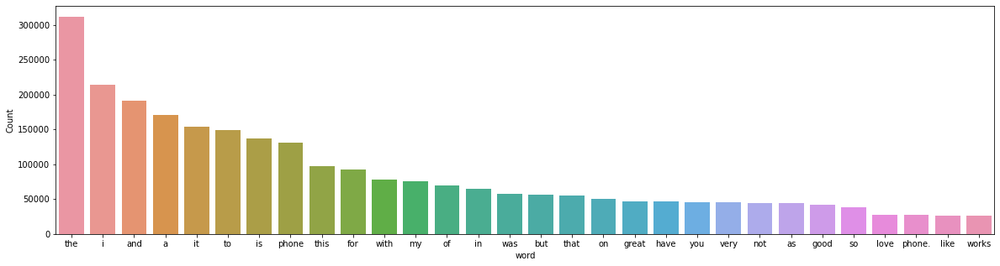

In [127]:
freq_words(positive_reviews['Reviews'])

In [128]:
# remove unwanted characters, numbers and symbols
positive_reviews['Reviews'] =positive_reviews['Reviews'].str.replace("[^a-zA-Z#]", " ")
##

In [129]:
# import stopwords library
from nltk.corpus import stopwords
stop_words = stopwords.words('english')

# function toremove stopwords and very short words (< 2 letters)
# from the review text
def remove_stopwords(rev):
    rev_new = " ".join([i for i in rev if i not in stop_words and i not in STOP_WORDS ])
    return rev_new

# remove short words
positive_reviews['Reviews'] = positive_reviews['Reviews'].apply(lambda x: 
                     ' '.join([w for w in x.split() if len(w)>2]))

# remove stopwords
reviews = [remove_stopwords(r.split()) for r in positive_reviews['Reviews']]

# lowercase the reviews
reviews = [r.lower() for r in reviews]
##

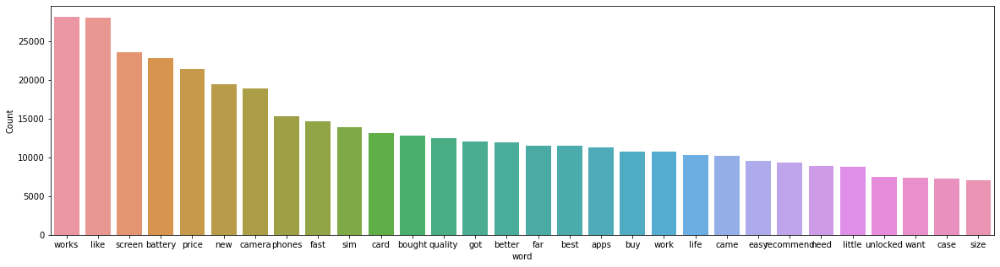

In [130]:
freq_words(reviews)

In [131]:
nlp = spacy.load('en_core_web_sm', disable = ['parser', 'ner'])
# function to filter noun and adjective
def lemmatization(texts, tags = ['NOUN', 'ADJ']):
    output = []
    for sent in texts:
        doc = nlp(" ".join(sent))
        output.append([token.lemma_ for token in doc if
                      token.pos_ in tags])
    return output

In [132]:
# tokenization
tokenized_reviews = pd.Series(reviews).apply(lambda x: x.split())

# an example after tokenization
print(tokenized_reviews[100])

['broke', 'plus', 'willing', 'pay', 'new', 'admit', 'little', 'leery', 'given', 'fact', 'long', 'user', 'careful', 'research', 'decided', 'idol', 'affordable', 'delivers', 'high', 'end', 'experience', 'looking', 'far', 'extremely', 'highly', 'recommend', 'shot', 'terms', 'speed', 'idol', 'noticeably', 'faster', 'web', 'environment', 'plus', 'terms', 'battery', 'barely', 'half', 'heavy', 'idol', 'ends', 'power', 'left', 'kind', 'usage', 'need', 'charge', 'technology', 'charges', 'super', 'fast', 'called', 'quick', 'charge', 'ton', 'pictures', 'fact', 'offers', 'flash', 'rear', 'sides', 'ability', 'expand', 'memory', 'micro', 'card', 'huge', 'plus', 'pictures', 'rarely', 'listen', 'music', 'internal', 'speakers', 'speakers', 'compared', 'huge', 'difference', 'surround', 'sound', 'affect', 'louder', 'phones', 'tried', 'googles', 'headphones', 'come', 'surprisingly', 'quality', 'throws', 'screen', 'protector', 'making', 'complete', 'package', 'customer', 'app', 'called', 'transfer', 'liter

In [133]:
# lemmatization
reviews_2 = lemmatization(tokenized_reviews)
#the above result followed by lemmatization
print(reviews_2[100])


['willing', 'pay', 'new', 'little', 'leery', 'fact', 'long', 'user', 'careful', 'research', 'idol', 'affordable', 'high', 'end', 'experience', 'shot', 'term', 'idol', 'fast', 'web', 'environment', 'term', 'half', 'heavy', 'idol', 'power', 'kind', 'usage', 'need', 'charge', 'technology', 'charge', 'quick', 'charge', 'ton', 'picture', 'fact', 'flash', 'rear', 'side', 'ability', 'memory', 'micro', 'card', 'huge', 'picture', 'music', 'internal', 'speaker', 'speaker', 'huge', 'difference', 'surround', 'sound', 'loud', 'phone', 'google', 'headphone', 'quality', 'throw', 'screen', 'protector', 'complete', 'package', 'customer', 'app', 'transfer', 'minute', 'transfer', 'contact', 'video', 'original', 'new', 'easy', 'matter', 'board', 'customer']


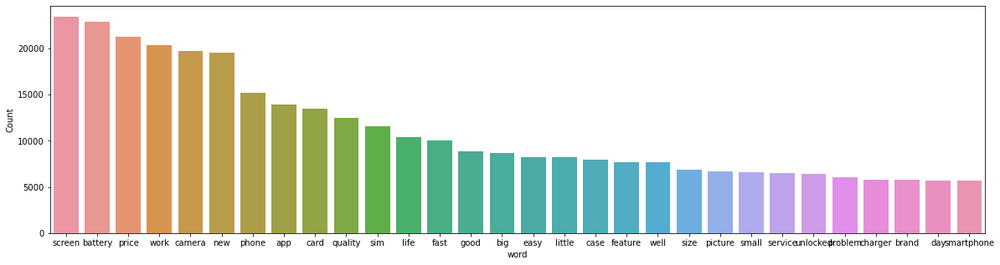

In [134]:
reviews_3 = []
for i in range(len(reviews_2)):
    reviews_3.append(' '.join(reviews_2[i]))
    
positive_reviews['Reviews']= reviews_3
freq_words(positive_reviews['Reviews'])

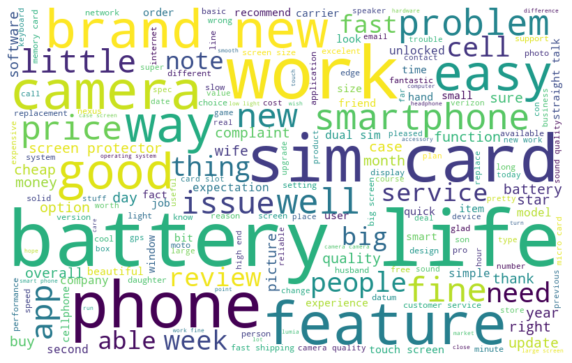

In [135]:
import matplotlib.pyplot as plt
all_words = ' '.join([text for text in positive_reviews['Reviews']])

from wordcloud import WordCloud
wordcloud = WordCloud(background_color='white',width = 800, height = 500, random_state = 21, 
                     max_font_size = 110).generate(all_words)
plt.figure(figsize = (10,7))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.show()


## Building the term dictionary of our corpus

In [136]:
dictionary = corpora.Dictionary(reviews_2)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in reviews_2]


# Creating a Latent Dirichlet Allocation (LDA) model

In [137]:
# Creating the LDA model using gensim
LDA = gensim.models.ldamodel.LdaModel

lda_model = LDA(corpus = doc_term_matrix, id2word = dictionary, 
                num_topics = 5, random_state = 100, 
               chunksize = 1000, passes = 50)


In [138]:
Topics=lda_model.print_topics()

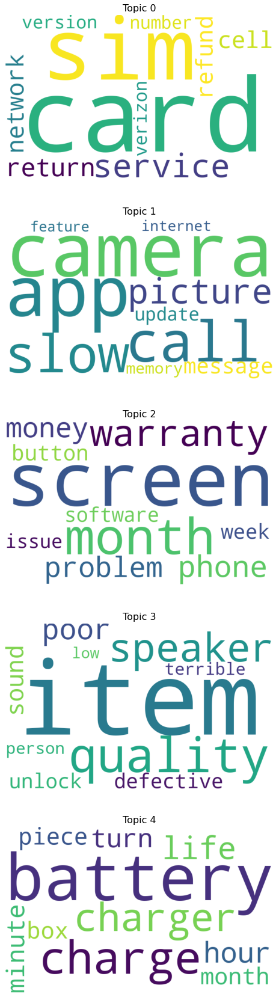

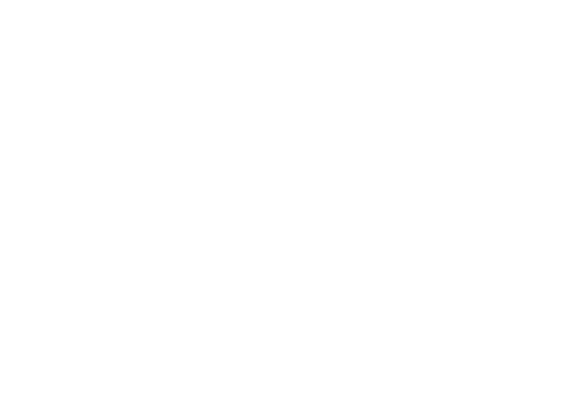

In [219]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud , STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=STOPWORDS,background_color='white',width = 800, height = 500, random_state = 21,max_words=30,
                     max_font_size = 110)



topics = lda_model.show_topics(formatted=False)


fig, axes = plt.subplots(5, 1, figsize=(30,30), sharex=True, sharey=True)
i=6
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
   
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.figure(figsize = (10,7))
#plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.show()

## Topics visulaization

In [140]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, doc_term_matrix, dictionary)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.175989  0.017034       1        1  34.609516
2     -0.108030 -0.174333       2        1  28.593151
3     -0.079487 -0.189893       3        1  15.862703
4     -0.056818  0.370671       4        1  11.341408
0      0.420324 -0.023479       5        1   9.593221, topic_info=        Term          Freq         Total Category  logprob  loglift
109    price  14597.000000  14597.000000  Default  30.0000  30.0000
39       new  17103.000000  17103.000000  Default  29.0000  29.0000
80      card  12066.000000  12066.000000  Default  28.0000  28.0000
26   battery  22437.000000  22437.000000  Default  27.0000  27.0000
16      work  19803.000000  19803.000000  Default  26.0000  26.0000
..       ...           ...           ...      ...      ...      ...
591      far    967.818575   1710.156481   Topic5  -4.9920   1.7748
43     quick   1158.768064   3860.954446   Topic5  -4.8119   1.1406
108   memory   1093.372192   3705.995429   Topic5  -4.8700   1.1234
78     worth    939.160655   2697.377991   Topic5  -5.0220   1.2891
515     star    950.377261   4123.557258   Topic5  -5.0102   0.8765

[244 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
63        1  0.344919        able
63        2  0.301171        able
63        3  0.353830        able
186       4  0.999080  affordable
269       5  0.999261        alot
...     ...       ...         ...
78        4  0.468974       worth
78        5  0.348116       worth
6         1  0.284406        year
6         2  0.305973        year
6         3  0.409536        year

[269 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 4, 5, 1])

## Topic modelling (using only negative sentiment)

In [141]:
Negative_reviews = df_biggest[df_biggest.Sentiment=="Negative"]

In [142]:
Negative_reviews.head()

,Unnamed: 0,Product Name,Brand Name,Price,Rating,Reviews,Review Votes,Sentiment,Review Length
5,5,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,1,i already had a phone with problems... i know ...,1.0,Negative,80
6,6,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,the charging port was loose. i got that solder...,0.0,Negative,42
7,7,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,"phone looks good but wouldn't stay charged, ha...",0.0,Negative,30
13,13,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,1,i'm really disappointed about my phone and ser...,1.0,Negative,98
15,15,"""CLEAR CLEAN ESN"" Sprint EPIC 4G Galaxy SPH-D7...",samsung,199.99,2,had this phone before and loved it but was not...,0.0,Negative,62


In [143]:
# function to plot most frequent words
def freq_words(x, words = 30):
    
    all_words = ' '.join([text for text in x])
    all_words = all_words.split()
    
    #frequency distribution
    fdist = FreqDist(all_words)
    words_df = pd.DataFrame({'word': list(fdist.keys()), 
                            'count': list(fdist.values())})
    # select the top 30 (default) most frequent words
    d = words_df.nlargest(columns = 'count', n = words)
    plt.figure(figsize = (20, 5))
    ax = sns.barplot(data = d, x = "word", y = "count")
    
    ax.set(ylabel = 'Count')
    plt.show()

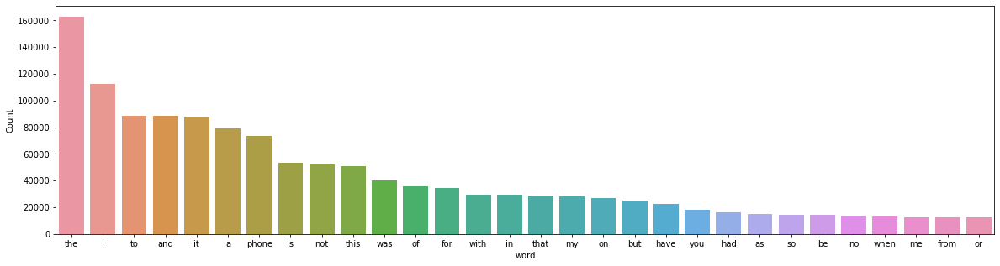

In [144]:
freq_words(Negative_reviews['Reviews'])

In [145]:
# remove unwanted characters, numbers and symbols
Negative_reviews['Reviews'] =Negative_reviews['Reviews'].str.replace("[^a-zA-Z#]", " ")

In [146]:
nlp.Defaults.stop_words |= {"IPhone","mobile","I","i","it","$","apple","phone",".","iphone","samsung","android","nice","love","good","great"
                           ,"'cause","-1","'S","'em","1","+3","-3","-The","-and",".25",".3",".5",".99"".I",".m",".It","bad","amazon","Amazon","seller","product","perfect","thing","use","issue","problem","excellent",
                            "device","thank","condition","old","awesome","amazing","galaxy","epic","wonderful","purchase","happy","excelente","que","day","year","month","satisfied","jbl","google","nokia","blu","lg","blackberry","motorola","htc","cnpgd","sony","posh mobile","huawei","asus","polaroid","zte","alcatel","verykool","lot",
                            "time","month","year","days","phone","problem","month","review","work","disappointed","week","text","hour",'article','Articles','page','wikipedia','talk','edit', 'one','make','please','like','see','think',
                            'know','source','go','also','time','add','people','user','well','need','block','may','want','link','image',
      'good','name','delete','find','look','thanks','work','remove','even','comment','help','write','information',
      'change','way','list','give','deletion','editor','question','section','point','thing','try','wiki',
      'first','wp','new','fact','seem','state','read','reference','discussion','right','thank','many','place','much',
      'ask','revert','really','mean','reason','call','include','sinc','edits','create','word','back','note','tag',
      'post','someone','policy','wiki','show','leave','issue','two','year','still','stop',"unlocked","cellphone"
      'content'}


In [147]:
# this line overrides the defaults stop words above , we have to remove it
import nltk
nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/snouto/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [148]:
# import stopwords library
### from nltk.corpus import stopwords
stop_words = stopwords.words('english')

# function toremove stopwords and very short words (< 2 letters)
# from the review text
def remove_stopwords(rev):
    rev_new = " ".join([i for i in rev if i not in stop_words and i not in STOP_WORDS ])
    return rev_new


In [149]:

# remove short words
Negative_reviews['Reviews'] = Negative_reviews['Reviews'].apply(lambda x: 
                     ' '.join([w for w in x.split() if len(w)>2]))

# remove stopwords
reviews = [remove_stopwords(r.split()) for r in Negative_reviews['Reviews']]

# lowercase the reviews
reviews = [r.lower() for r in reviews]

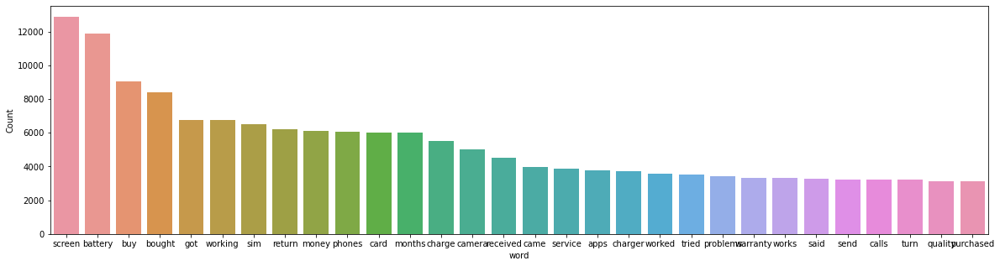

In [150]:
freq_words(reviews)

In [151]:
nlp = spacy.load('en_core_web_sm', disable = ['parser', 'ner'])
# function to filter noun and adjective
def lemmatization(texts, tags = ['NOUN', 'ADJ']):
    output = []
    for sent in texts:
        doc = nlp(" ".join(sent))
        output.append([token.lemma_ for token in doc if
                      token.pos_ in tags])
    return output

In [152]:
## tokenization
tokenized_reviews = pd.Series(reviews).apply(lambda x: x.split())

# an example after tokenization
print(tokenized_reviews[100])

['sent', 'box', 'sealed', 'plastic', 'screen', 'clearly', 'removed', 'reapplied', 'hair', 'underneath', 'attempted', 'exchange', 'offered', 'return', 'option', 'sent', 'fault', 'bit', 'lag', 'reviewers', 'blame', 'specs', 'obviously', 'skin', 'sure', 'simple', 'ota', 'solve', 'problems', 'double', 'tap', 'feature', 'worked', 'screen', 'bright', 'color', 'speakers', 'best', 'feature', 'sound', 'quality', 'speakers', 'close', 'surprisingly', 'headphone', 'jack', 'weak', 'headphones', 'klipsch', 'headphones', 'loud', 'zenfone', 'better', 'headphone', 'output', 'liked', 'liked', 'giving', 'passed', 'sent', 'returned', 'root', 'vanilla', 'rom', 'decent', 'pretty', 'build', 'quality', 'screen', 'sound', 'beats', 'high', 'end', 'flagships', 'shame', 'sent', 'equipment']


In [153]:
# lemmatization
reviews_2 = lemmatization(tokenized_reviews)
#the above result followed by lemmatization
print(reviews_2[2])

['buy', 'battery', 'stay', 'money', 'buy', 'person']


In [154]:
reviews_2

[['problem',
  'dang',
  'charge',
  'wish',
  'comment',
  'item',
  'good',
  'charge',
  'money',
  'money',
  'unhappy',
  'customer'],
 ['port', 'battery', 'cost', 'usable'],
 ['buy', 'battery', 'stay', 'money', 'buy', 'person'],
 ['service',
  'dollar',
  'service',
  'mailing',
  'label',
  'return',
  'item',
  'smartphone',
  'business',
  'deal'],
 ['working',
  'card',
  'slot',
  'open',
  'access',
  'file',
  'managment',
  'computer',
  'card',
  'able',
  'open',
  'trouble'],
 ['son',
  'sprint',
  'clear',
  'store',
  'research',
  'company',
  'clean',
  'send',
  'representative',
  'clear',
  'available',
  'wrong',
  'clear',
  'representative',
  'sprint',
  'phone',
  'aware',
  'clear',
  'send',
  'refund',
  'shipping',
  'phone',
  'clear',
  'refund',
  'refund',
  'shipping'],
 [],
 ['screen',
  'resolution',
  'storage',
  'low',
  'card',
  'clear',
  'thing',
  'freedompop'],
 ['phone', 'charger', 'port'],
 ['mom'],
 ['arabian', 'keyboard'],
 ['simple'

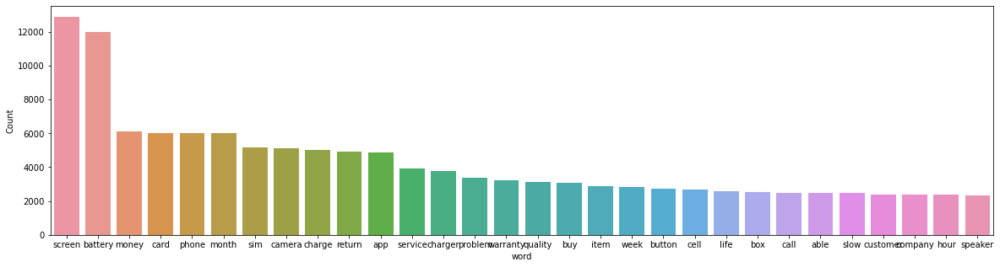

In [155]:
reviews_3 = []
for i in range(len(reviews_2)):
    reviews_3.append(' '.join(reviews_2[i]))
    
Negative_reviews['Reviews']= reviews_3
freq_words(Negative_reviews['Reviews'])

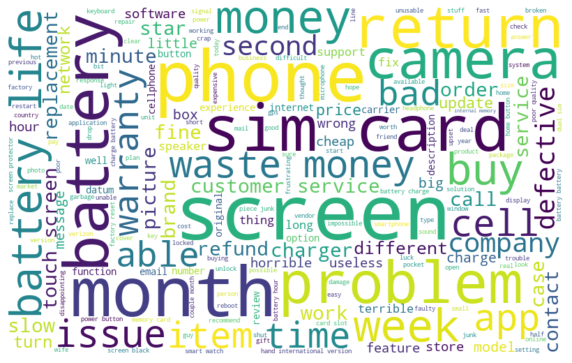

In [156]:
all_words = ' '.join([text for text in Negative_reviews['Reviews']])

from wordcloud import WordCloud
wordcloud = WordCloud(background_color='white',width = 800, height = 500, random_state = 21, 
                     max_font_size = 110).generate(all_words)
plt.figure(figsize = (10,7))
plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.show()


In [157]:
dictionary = corpora.Dictionary(reviews_2)
doc_term_matrix = [dictionary.doc2bow(rev) for rev in reviews_2]


# Creating a Latent Dirichlet Allocation (LDA) model

In [158]:
# Creating the LDA model using gensim
LDA = gensim.models.ldamodel.LdaModel

lda_model = LDA(corpus = doc_term_matrix, id2word = dictionary, 
                num_topics = 5, random_state = 100, 
               chunksize = 1000, passes = 50)

In [159]:
Topics=lda_model.print_topics()

In [160]:
Topics

[(0,
  '0.045*"card" + 0.044*"sim" + 0.024*"service" + 0.022*"return" + 0.020*"network" + 0.019*"cell" + 0.019*"refund" + 0.018*"version" + 0.017*"verizon" + 0.017*"number"'),
 (1,
  '0.044*"camera" + 0.039*"app" + 0.024*"call" + 0.023*"slow" + 0.021*"picture" + 0.014*"message" + 0.014*"update" + 0.013*"memory" + 0.011*"internet" + 0.011*"feature"'),
 (2,
  '0.070*"screen" + 0.024*"month" + 0.022*"warranty" + 0.020*"phone" + 0.018*"problem" + 0.017*"money" + 0.014*"button" + 0.012*"week" + 0.012*"software" + 0.011*"issue"'),
 (3,
  '0.027*"item" + 0.026*"quality" + 0.024*"speaker" + 0.022*"poor" + 0.014*"sound" + 0.013*"defective" + 0.013*"unlock" + 0.012*"terrible" + 0.012*"person" + 0.010*"low"'),
 (4,
  '0.106*"battery" + 0.045*"charge" + 0.037*"charger" + 0.022*"life" + 0.018*"hour" + 0.015*"turn" + 0.014*"minute" + 0.013*"piece" + 0.012*"box" + 0.012*"month"')]

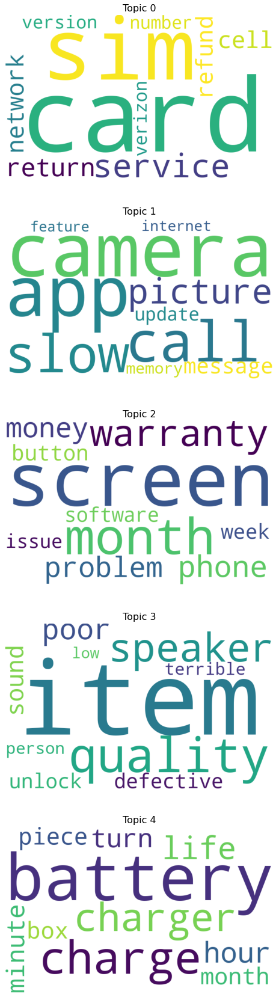

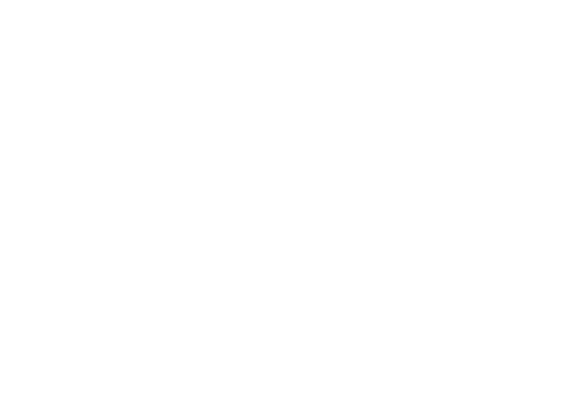

In [220]:
from matplotlib import pyplot as plt
from wordcloud import WordCloud, STOPWORDS
import matplotlib.colors as mcolors

cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]  # more colors: 'mcolors.XKCD_COLORS'

cloud = WordCloud(stopwords=STOPWORDS,background_color='white',width = 800, height = 500, random_state = 21,max_words=30,
                     max_font_size = 110)



topics = lda_model.show_topics(formatted=False)


fig, axes = plt.subplots(5, 1, figsize=(30,30), sharex=True, sharey=True)
i=6
for i, ax in enumerate(axes.flatten()):
    fig.add_subplot(ax)
    topic_words = dict(topics[i][1])
    cloud.generate_from_frequencies(topic_words, max_font_size=300)
   
    plt.gca().imshow(cloud)
    plt.gca().set_title('Topic ' + str(i), fontdict=dict(size=16))
    plt.gca().axis('off')


plt.figure(figsize = (10,7))
#plt.imshow(wordcloud, interpolation = 'bilinear')
plt.axis('off')
plt.show()

## Topics visulaization

In [162]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model, doc_term_matrix, dictionary)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2     -0.123208 -0.048169       1        1  27.265844
1      0.320105  0.215304       2        1  19.760139
4     -0.212757  0.027248       3        1  18.954656
0     -0.132779  0.142722       4        1  18.111143
3      0.148639 -0.337106       5        1  15.908219, topic_info=           Term          Freq         Total Category  logprob  loglift
10      battery  12424.000000  12424.000000  Default  30.0000  30.0000
53       screen  11726.000000  11726.000000  Default  29.0000  29.0000
82       camera   5394.000000   5394.000000  Default  28.0000  28.0000
0        charge   5238.000000   5238.000000  Default  27.0000  27.0000
27         card   5035.000000   5035.000000  Default  26.0000  26.0000
..          ...           ...           ...      ...      ...      ...
524    function    698.325564   1202.563347   Topic5  -4.9445   1.2948
314         end    655.503027   1000.798042   Topic5  -5.0078   1.4152
513  experience    613.890437   1235.700084   Topic5  -5.0734   1.1388
40        phone    669.712206   5889.150303   Topic5  -4.9864  -0.3357
22       return    632.606158   4989.062567   Topic5  -5.0434  -0.2268

[261 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
25        2  0.347360       able
25        4  0.652627       able
316       3  0.997933  accessory
781       4  0.998943    account
831       2  0.997894   annoying
...     ...       ...        ...
140       2  0.998628     window
1304      4  0.999229   wireless
34        1  0.998524    working
141       1  0.867231      worth
141       3  0.132231      worth

[309 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 2, 5, 1, 4])

# Scatter Text

In [163]:
df_biggest = df_biggest.groupby('Sentiment').apply(lambda x: x.sample(n=21000, random_state=1))

In [164]:
#!pip install scattertext

In [165]:
import scattertext as st

In [166]:
# function toremove stopwords and very short words (< 2 letters)
# from the review text
def remove_stopwords(rev):
    rev_new = " ".join([i for i in rev if i not in stop_words and i not in STOP_WORDS ])
    return rev_new

df_biggest['Reviews'] = df_biggest['Reviews'].str.replace("[^a-zA-Z#]", " ")
df_biggest['Reviews'] = [remove_stopwords(r.split()) for r in df_biggest['Reviews']]
df_biggest['Reviews'] = df_biggest['Reviews'].apply(lambda x: 
                     ' '.join([w for w in x.split() if len(w)>3]))


In [167]:
### Function to perform scatter text on any data frame with a name as the output file name
def scatter_text(df,name):
    df = df.copy()
    df.drop(['Sentiment'],inplace=True,axis=1)
    df=df.reset_index()
    corpus = st.CorpusFromPandas(df,
                                 category_col='Sentiment',
                                 text_col='Reviews',
                                 nlp=st.whitespace_nlp_with_sentences
                                ).build()
    html = st.produce_scattertext_explorer(
        corpus,
        category='Positive',
        category_name='Positive',
        not_category_name='Negative',
        minimum_term_frequency=10,
        pmi_threshold_coefficient=5,
        width_in_pixels=1000,
        )
    open(f'{name}.scattertext.html', 'wb').write(html.encode('utf-8'))

In [168]:
### produce scatter text for positive reviews
scatter_text(df_biggest.sample(n=10000,random_state=0),"reviews")


# Using CorEx

## positive revews

In [169]:
from corextopic import corextopic as ct
from corextopic import vis_topic as vt
import numpy as np
import scipy.sparse as ss


In [170]:
vectorizer = CountVectorizer(max_features=20000,
                             stop_words='english', token_pattern="\\b[a-z][a-z]+\\b",
                             binary=True)

doc_word = vectorizer.fit_transform(positive_reviews.Reviews)
words = list(np.asarray(vectorizer.get_feature_names()))

In [171]:

topic_model = ct.Corex(n_hidden=10, words=words,seed=42)
topic_model.fit(doc_word, words=words, docs=positive_reviews.Reviews)

In [172]:
topics = topic_model.get_topics()
topics

[[('camera', 0.09180766964723652, 1.0),
  ('app', 0.08935444432857147, 1.0),
  ('card', 0.07964960725232591, 1.0),
  ('sim', 0.05969775858497444, 1.0),
  ('video', 0.046946714514850496, 1.0),
  ('memory', 0.0400039264632624, 1.0),
  ('picture', 0.03775451568408785, 1.0),
  ('storage', 0.03130426246214283, 1.0),
  ('micro', 0.02985603526177581, 1.0),
  ('game', 0.029236437145393347, 1.0)],
 [('quality', 0.03804225321405958, 1.0),
  ('low', 0.022257203677832953, 1.0),
  ('pro', 0.021980603790113292, 1.0),
  ('fingerprint', 0.020669997950789592, 1.0),
  ('good', 0.01743171091328339, 1.0),
  ('point', 0.01712111538435638, 1.0),
  ('performance', 0.016947618534067198, 1.0),
  ('design', 0.016097863963216483, 1.0),
  ('device', 0.013677136418747465, 1.0),
  ('stock', 0.013497705929821089, 1.0)],
 [('small', 0.038543065543732165, 1.0),
  ('button', 0.03789481907937713, 1.0),
  ('speaker', 0.03411100573103662, 1.0),
  ('size', 0.033694327753525245, 1.0),
  ('text', 0.03301739130751139, 1.0),
 

In [173]:
# Print all topics from the CorEx topic model
topics = topic_model.get_topics()
for n,topic in enumerate(topics):
    topic_words,_,_ = zip(*topic)
    print('{}: '.format(n) + ','.join(topic_words))

0: camera,app,card,sim,video,memory,picture,storage,micro,game
1: quality,low,pro,fingerprint,good,point,performance,design,device,stock
2: small,button,speaker,size,text,hand,way,keyboard,able,large
3: battery,screen,life,case,big,charge,day,little,long,hour
4: phone,review,feature,user,high,thing,end,year,need,finger
5: color,right,note,cheap,solid,black,deal,water,headphone,difference
6: unlocked,version,service,network,international,carrier,minute,support,contact,customer
7: music,people,easy,smart,plan,smartphone,experience,radio,player,medium
8: new,brand,box,work,charger,original,store,scratch,issue,verizon
9: price,money,model,face,eye,value,friend,cell,reasonable,gift


In [174]:
#plt.figure(figsize=(10,5))
#plt.bar(range(topic_model.tcs.shape[0]), topic_model.tcs, color='#4e79a7', width=0.5)
#plt.xlabel('Topic', fontsize=16)
#plt.ylabel('Total Correlation (nats)', fontsize=16);

In [175]:
topic_model = ct.Corex(n_hidden=10, words=words,
                       max_iter=200, verbose=False, seed=42)

topic_model.fit(doc_word, words=words, docs=positive_reviews.Reviews,
                anchors=[['screen'],
                         ['loud','speaker'],
                         ['quality','performance'],
                         ['card','sim','sync'],
                         ['charger', 'cable']], anchor_strength=5)

# Print all topics from the CorEx topic model
topics = topic_model.get_topics()

for n,topic in enumerate(topics):
    topic_words,_,_ = zip(*topic)
    print('{}: '.format(n) + ','.join(topic_words))

0: screen,protector,big,size,touch,large,resolution,inch,sensitive,crystal
1: speaker,loud,app,video,music,button,picture,way,update,game
2: quality,performance,build,ratio,relation,rival,midrange,luxurious,lab,relationship
3: card,sim,sync,dual,micro,slot,memory,local,travel,ready
4: charger,cable,headphone,adapter,port,plug,earbud,cord,european,earphone
5: unlocked,able,version,easy,network,carrier,free,year,international,smartphone
6: glass,recomiendo,todo,por,producto,gorilla,llego,este,buen,sin
7: battery,life,camera,case,charge,light,day,long,hour,high
8: small,feature,datum,keyboard,hand,people,plan,number,service,need
9: new,phone,review,work,brand,little,box,talk,store,straight


### using cores on Negative reviews

In [176]:
Negative_reviews = df_biggest[df_biggest.Sentiment =='Negative']

In [177]:
vectorizer = CountVectorizer(max_features=20000,
                             stop_words='english', token_pattern="\\b[a-z][a-z]+\\b",
                             binary=True)

doc_word = vectorizer.fit_transform(Negative_reviews.Reviews)
words = list(np.asarray(vectorizer.get_feature_names()))

In [178]:
topic_model = ct.Corex(n_hidden=10, words=words,seed=42)
topic_model.fit(doc_word, words=words, docs=Negative_reviews.Reviews)

In [179]:
topics = topic_model.get_topics()
topics

[[('telefono', 0.011145507642326814, 1.0),
  ('como', 0.009855454829918408, 1.0),
  ('nuevo', 0.009119263130548522, 1.0),
  ('este', 0.009119261320136969, 1.0),
  ('llego', 0.008199990913005838, 1.0),
  ('para', 0.007697737396308696, 1.0),
  ('compre', 0.007649010775450578, 1.0),
  ('range', 0.007436188470367833, 1.0),
  ('fono', 0.006731539907728903, 1.0),
  ('esta', 0.005998355688852068, 1.0)],
 [('better', 0.042348102278334854, 1.0),
  ('phones', 0.04140860719996832, 1.0),
  ('quality', 0.03012929077708136, 1.0),
  ('little', 0.024767245696641266, 1.0),
  ('things', 0.02058339675637181, 1.0),
  ('case', 0.01956871742230866, 1.0),
  ('reviews', 0.018131872676994856, 1.0),
  ('cheap', 0.01735597053448472, 1.0),
  ('best', 0.01725257976244625, 1.0),
  ('memory', 0.016555523137557718, 1.0)],
 [('battery', 0.09681603106718013, 1.0),
  ('screen', 0.06658362525234081, 1.0),
  ('life', 0.04735754472049798, 1.0),
  ('apps', 0.0343528614944037, 1.0),
  ('times', 0.033571877840609415, 1.0),
  

In [180]:
# Print all topics from the CorEx topic model
topics = topic_model.get_topics()
for n,topic in enumerate(topics):
    topic_words,_,_ = zip(*topic)
    print('{}: '.format(n) + ','.join(topic_words))

0: telefono,como,nuevo,este,llego,para,compre,range,fono,esta
1: better,phones,quality,little,things,case,reviews,cheap,best,memory
2: battery,screen,life,apps,times,camera,charge,hours,fast,minutes
3: music,calls,sure,going,price,hear,issues,getting,called,software
4: pros,plus,cons,media,video,pocket,player,social,default,hand
5: service,customer,warranty,told,return,number,purchased,reset,contacted,replacement
6: update,fine,support,data,wifi,able,works,internet,finally,connection
7: version,received,charger,card,description,came,original,ordered,international,opened
8: tried,wanted,takes,thought,online,looking,pretty,different,settings,experience
9: working,stopped,months,money,bought,waste,weeks,went,repair,couple


In [181]:
#plt.figure(figsize=(10,5))
#plt.bar(range(topic_model.tcs.shape[0]), topic_model.tcs, color='#4e79a7', width=0.5)
#plt.xlabel('Topic', fontsize=16)
#plt.ylabel('Total Correlation (nats)', fontsize=16);

In [182]:
topic_model = ct.Corex(n_hidden=6, words=words,
                       max_iter=200, verbose=False, seed=42)

topic_model.fit(doc_word, words=words, docs=Negative_reviews.Reviews,
                anchors=[[ 'screen'],
                         ['loud','speaker'],
                         ['quality','performance'],
                         ['memory','ram'],
                         ['card','sim'],
                         ['charger', 'cable']],
                          anchor_strength=5)

# Print all topics from the CorEx topic model
topics = topic_model.get_topics()
#for n,topic in enumerate(topics):
    #topic_words,_ = zip(*topic)
   # print('{}: '.format(n) + ','.join(topic_words))
for n,topic in enumerate(topics):
    topic_words,_,_ = zip(*topic)
    print('{}: '.format(n) + ','.join(topic_words))

0: screen,touch,black,cracked,protector,dropped,light,unresponsive,lines,white
1: speaker,loud,hear,music,sound,calls,volume,telefono,player,voice
2: quality,performance,better,phones,camera,poor,price,customer,best,cheap
3: memory,apps,update,times,things,life,going,little,software,support
4: card,slot,micro,recognize,sims,inserted,network,cards,insert,carrier
5: charger,cable,battery,warranty,charge,tried,bought,took,purchased,months


##### Component 1 (topic 1) seems to be about Screen Features
##### Component 2 (topic 2) seems to be about Sound Features
##### Component 3 (topic 3) seems to be about Quality
##### Component 4 (topic 4) seems to be about Memory
##### Component 5 (topic 5) seems to be about Card
##### Component 6 (topic 6) seems to be about Mobile Accessaries

# add coloumn name Toknize

In [183]:
parsed_reviews = pd.Series(nlp.pipe(df_biggest['Reviews'], disable=['parser', 'ner']))
# tokenize the Reviews and convert them into DF Series

In [184]:
# this function calculates the term frequencya matrix for the passed-in Data Frame Column
def split_column(column):
    from sklearn.feature_extraction.text import CountVectorizer
    cv = CountVectorizer(tokenizer = lambda x: x, lowercase=False, max_df=0.5, min_df=2, max_features=10000)
    data = cv.fit_transform(column)
    cdf = pd.DataFrame(data.toarray(),columns=cv.get_feature_names())
    return cdf

In [185]:
pd.DataFrame(doc_word.toarray(),columns=vectorizer.get_feature_names())

,aaaalll,aag,aand,aaps,aazt,aback,abandonados,abandoned,abbreviated,abcd,...,zmax,zone,zones,zoom,zooming,zooms,zoto,zrblanco,zune,zunes
0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20995,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20996,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20997,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
20998,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [186]:
# Drop N/A records for the subset Reviews.
df = df.dropna(subset=['Reviews'])

In [187]:
# Drop duplicated Rows, modify the original data set
df.drop_duplicates(inplace=True)

In [188]:
# this function removes any special characters that is not part of the canonical english alphanumerics
def remove_special_letters(txt):
    import re
    text = re.sub("\\b[a-z][a-z]+\\b"," ",txt)
    return text

In [189]:
df_biggest.head()

Unnamed: 0  \
Sentiment                      
Negative  168291      247059   
          52988        83347   
          68422       104360   
          230304      348788   
          170160      249747   

                                                       Product Name  \
Sentiment                                                             
Negative  168291  Motorola Droid 4 XT894 4G LTE Black - Verizon ...   
          52988   BlackBerry 8220 Flip Pearl Unlocked Phone with...   
          68422   BLU Advance 4.0L Unlocked Smartphone -Global G...   
          230304  Samsung Galaxy S5 G900F Unlocked Cellphone, In...   
          170160  Motorola KRZR K1 Unlocked Phone with 2 MP Came...   

                  Brand Name   Price  Rating  \
Sentiment                                      
Negative  168291    motorola  224.00       1   
          52988   blackberry  269.10       1   
          68422          blu  149.99       2   
          230304     samsung  328.99       1   
          170160    motorola   44.00       1   

                                                            Reviews  \
Sentiment                                                             
Negative  168291                                   defective worked   
          52988   arrived conditions answered claim service reco...   
          68422                                              crappy   
          230304                                    plenty problems   
          170160  european version manual indecipherable menus l...   

                  Review Votes Sentiment  Review Length  
Sentiment                                                
Negative  168291           0.0  Negative              6  
          52988            0.0  Negative             20  
          68422            0.0  Negative              2  
          230304           1.0  Negative              5  
          170160           2.0  Negative            220

In [190]:
df_biggest['Reviews'] = df_biggest['Reviews'].apply(remove_special_letters)
df_biggest.head()

Unnamed: 0  \
Sentiment                      
Negative  168291      247059   
          52988        83347   
          68422       104360   
          230304      348788   
          170160      249747   

                                                       Product Name  \
Sentiment                                                             
Negative  168291  Motorola Droid 4 XT894 4G LTE Black - Verizon ...   
          52988   BlackBerry 8220 Flip Pearl Unlocked Phone with...   
          68422   BLU Advance 4.0L Unlocked Smartphone -Global G...   
          230304  Samsung Galaxy S5 G900F Unlocked Cellphone, In...   
          170160  Motorola KRZR K1 Unlocked Phone with 2 MP Came...   

                  Brand Name   Price  Rating  \
Sentiment                                      
Negative  168291    motorola  224.00       1   
          52988   blackberry  269.10       1   
          68422          blu  149.99       2   
          230304     samsung  328.99       1   
          170160    motorola   44.00       1   

                                                            Reviews  \
Sentiment                                                             
Negative  168291                                                      
          52988                                                       
          68422                                                       
          230304                                                      
          170160                                                ...   

                  Review Votes Sentiment  Review Length  
Sentiment                                                
Negative  168291           0.0  Negative              6  
          52988            0.0  Negative             20  
          68422            0.0  Negative              2  
          230304           1.0  Negative              5  
          170160           2.0  Negative            220

In [191]:
pd.set_option('display.max_columns', 100)

In [192]:
# Only include English alphanumerical words and exclude any other non-english canonical words

df_biggest['Tokenized'] = [[t.lemma_ for t in review \
                            if not t.is_punct  \
                            and not t.lemma_ in STOP_WORDS  \
                            and not t.lemma_ == '-PRON-'] for review in parsed_reviews]


In [193]:
# Create the term frequency matrix for The already prepared Tokenized Column

total_term_matrix = split_column(df_biggest['Tokenized'])
total_term_matrix.head(n=10)

,aaaaa,aaaaaand,aactivate,aap,abandon,abierto,ability,abke,able,abnormal,abnormally,abort,abou,abrasion,abreast,abrirlo,abroad,abruptly,absence,absent,absolute,absolutely,absolutly,absorb,absurd,abundant,abuse,abused,abusive,abysmal,acabado,acabo,acatel,acce,accelerate,accelerometer,accent,accept,acceptable,accepted,accesible,accesorie,accesorio,access,accessary,accessibility,accessible,accessing,accessorie,accessories,...,yeah,yearly,yearpiss,yeat,yell,yellow,yellowish,yelp,yess,yesterday,yesturday,yesyou,yezz,yield,yike,yippee,ymmv,yoga,yoigo,york,youafter,youdual,youjust,young,youremail,youtu,youtube,yutil,zaarn,zagg,zain,zambia,zealand,zedge,zeiss,zenfone,zenfones,zenphone,zenui,zenwatch,zero,zippier,zippy,zizo,zmax,zoey,zone,zoom,zooming,zune
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [194]:
total_term_matrix.shape

(63000, 10000)

In [195]:
df.to_csv('df_biggest.csv')

## transform it to PCA

In [196]:
from sklearn.decomposition import PCA
from sklearn.feature_extraction.text import CountVectorizer 
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import NMF
from sklearn.metrics.pairwise import cosine_similarity

In [197]:
pca = PCA(n_components=2)
pca.fit(total_term_matrix)
pcafeatures_train = pca.transform(total_term_matrix)

In [198]:
pcafeatures_train

array([[-0.51744252, -0.03212534],
       [-0.40585265, -0.04659528],
       [-0.52313118, -0.04219087],
       ...,
       [-0.46411941, -0.05114097],
       [-0.33320893,  0.02977952],
       [-0.52598039, -0.04107728]])

In [199]:
pca.explained_variance_ratio_

array([0.06820059, 0.01942594])

In [200]:
pd.DataFrame(pca.components_, index = ['PC1','PC2'])

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,...,9950,9951,9952,9953,9954,9955,9956,9957,9958,9959,9960,9961,9962,9963,9964,9965,9966,9967,9968,9969,9970,9971,9972,9973,9974,9975,9976,9977,9978,9979,9980,9981,9982,9983,9984,9985,9986,9987,9988,9989,9990,9991,9992,9993,9994,9995,9996,9997,9998,9999
PC1,-0.000026,0.000497,-0.000039,-0.000021,0.000447,-0.000017,0.010070,-0.000014,0.053402,0.000674,0.000087,0.000007,0.000092,0.000228,0.001585,-0.000028,0.001174,0.000108,0.000067,0.000548,0.001648,0.012915,0.000026,0.000121,0.000474,0.000100,0.001471,0.000046,0.000077,0.000116,-0.000021,-0.000021,0.000357,0.000002,0.001233,0.00220,0.001011,0.005543,0.006687,0.000010,-0.000014,0.000201,-0.000257,0.027257,0.000129,0.000845,0.001729,0.000096,0.000022,0.000029,...,0.003526,-0.000009,0.000018,0.000043,0.000149,0.002427,0.000114,0.000087,-0.000028,0.003113,0.000031,0.000013,0.000006,0.000344,0.000015,0.000060,0.000388,0.000230,-0.000008,0.000365,0.000009,0.000267,-0.000011,0.000871,0.000059,0.000085,0.012907,-0.000014,0.000015,0.000058,0.000062,0.000003,0.000031,0.000352,0.000154,0.006092,0.000024,0.000601,0.000671,0.000021,0.005537,-0.000005,0.001078,0.000064,0.000812,0.000135,0.002556,0.008349,0.000237,0.001135
PC2,-0.000009,-0.000028,-0.000012,-0.000007,-0.000194,-0.000010,0.000748,-0.000014,-0.002719,-0.000995,-0.000121,0.000078,-0.000149,0.000397,-0.002631,-0.000012,-0.000454,0.000137,-0.000075,-0.000267,0.000009,-0.000512,-0.000020,0.000114,-0.000650,-0.000092,-0.000477,0.000229,0.000154,0.000027,-0.000006,-0.000023,-0.000376,-0.000036,-0.000635,-0.00293,-0.001031,0.000971,-0.000039,-0.000055,-0.000050,0.000108,-0.000163,-0.008500,-0.000037,-0.000285,0.000611,-0.000055,0.000124,0.000024,...,-0.001106,-0.000008,-0.000007,0.000036,-0.000181,-0.000542,0.000089,-0.000023,-0.000008,-0.000186,0.000122,-0.000066,-0.000054,-0.000059,-0.000084,0.000082,-0.000285,-0.000126,-0.000010,0.000214,-0.000044,0.000217,-0.000003,-0.000954,-0.000171,-0.000196,-0.002393,-0.000004,0.000070,-0.000096,-0.000015,0.000111,0.000089,-0.000317,-0.000177,-0.002534,-0.000027,-0.000834,-0.000028,0.000052,-0.001392,-0.000009,-0.000927,0.000008,-0.000709,-0.000099,0.000808,-0.001061,-0.000133,-0.000189


In [201]:
import warnings
warnings.filterwarnings(action='ignore')

In [202]:
# gensim
from gensim import corpora, models, similarities, matutils

# sklearn
from sklearn import datasets

# logging for gensim (set to INFO)

# Clustering 

In [203]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'
    alpha = 0.5
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1])
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1])

In [204]:
### KMeans Clustering 
def kmeans_clustering(input_data,num_comps=10):
    from sklearn.cluster import KMeans
    km = KMeans(n_clusters=num_comps,random_state=10,n_init=1)
    km.fit(input_data)
    display_cluster(input_data,km,num_comps)

In [205]:
# Hierarchical Clustering
def clustering_HC(input_data,num_comps=10):
    from time import time
    from sklearn.cluster import AgglomerativeClustering
    import matplotlib.pyplot as plt
    clustering = AgglomerativeClustering(linkage='ward',n_clusters=num_comps)
    clustering.fit_predict(input_data)
    plt.figure(dpi=200)
    plt.scatter(input_data[:,0],input_data[:,1],c=clustering.labels_, cmap='rainbow')
    plt.title("Hierarchical Clustering for Topic Modeling")

In [206]:
### Spectral Clustering
def spectral_clustering(input_data,num_comps=10):
    from sklearn.cluster import SpectralClustering
    import matplotlib.pyplot as plt

    sc = SpectralClustering(n_clusters=num_comps)
    ypred = sc.fit_predict(input_data)
    x,y = zip(*input_data)
    plt.figure(dpi=200)
    plt.scatter(input_data[:,0],input_data[:,1])

In [207]:
### T-SNE Clustering
def tsne_clustering(input_data,num_comps=10,num_points=100,num_dim=30):
    from sklearn.manifold import TSNE
    model = TSNE(n_components=num_comps,random_state=0,verbose=2)
    low_data = model.fit_transform(input_data)
    x,y = zip(*low_data)
    colorize = []
    for i in range(num_comps):
        colorize.append(plt.cm.rainbow(i*20))
    plt.scatter(x,y,c=colorize,s=40)





In [208]:
### Elbow Diagram for K-Means
def determine_clusters(input_data,num_comps=10):
    from sklearn.cluster import KMeans
    inertia = []
    list_num_clusters = list(range(1,num_comps+1))
    for clust in list_num_clusters:
        km = KMeans(n_clusters=clust)
        km.fit(input_data)
        inertia.append(km.inertia_)
    plt.plot(list_num_clusters,inertia)
    plt.scatter(list_num_clusters,inertia)
    plt.xlabel("number of clusters")
    plt.ylabel("inertia")

In [209]:
### Lemmatization
from nltk.stem import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()
stemming = lambda x: lemmatizer.lemmatize(x)
positive_reviews['Reviews'] = positive_reviews['Reviews'].apply(stemming)

In [210]:
def calc_entropy(word):
    from scipy.stats import entropy
    import pandas as pd
    convert = lambda x: [ord(r) for r in x]
    series = pd.Series(convert(word))
    counts = series.value_counts()
    return entropy(counts)



In [211]:
### vectorizer
vectorizer = CountVectorizer(stop_words='english',token_pattern="\\b[a-z][a-z]+\\b")
doc_word = vectorizer.fit_transform(positive_reviews['Reviews'])


In [212]:
doc_word_df = pd.DataFrame(doc_word.toarray(),columns=vectorizer.get_feature_names())

choose_column = lambda col: True if calc_entropy(col) > 2 else False
mask_df = [choose_column(col) for col in vectorizer.get_feature_names()]
doc_word_df=doc_word_df.loc[:,mask_df]

In [222]:
def perform_clustering(sentiment_type='Positive',num_comps=2
                       ,clustering_func=kmeans_clustering):
    global df_biggest
    vectorizer = CountVectorizer(stop_words='english',token_pattern="\\b[a-z][a-z]+\\b")
    df = df_biggest[df_biggest.Sentiment == sentiment_type]
    doc_word = vectorizer.fit_transform(df['Reviews'])
    doc_word_df = pd.DataFrame(doc_word.toarray(),columns=vectorizer.get_feature_names())
    choose_column = lambda col: True if calc_entropy(col) > 2 else False
    mask_df = [choose_column(col) for col in vectorizer.get_feature_names()]
    doc_word_df=doc_word_df.loc[:,mask_df]
    lsa = TruncatedSVD(n_components=num_comps,n_iter=7,random_state=42)
    lsa.fit(doc_word_df)
    doc_topic = lsa.transform(doc_word_df)
    clustering_func(doc_topic,num_comps=num_comps)
    return doc_topic
    

In [214]:
### Number of Components
num_comps = 2
lsa = TruncatedSVD(n_components=num_comps,n_iter=7,random_state=42)
lsa.fit(doc_word_df)
doc_topic = lsa.transform(doc_word_df)

In [215]:
doc_topic.shape

(182032, 2)

## Kmeans Clustering

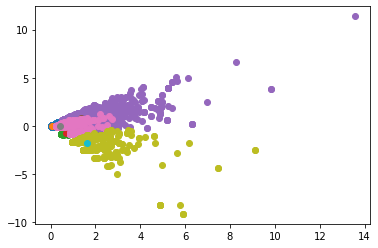

In [226]:
### Perform K-means Clustering on Positive Sentiment
p_doc_topic = perform_clustering(num_comps=5)

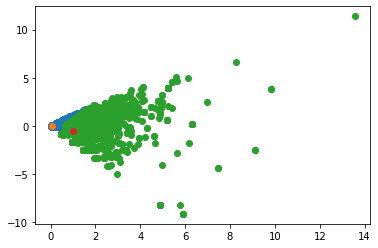

In [227]:
### Perform K-means Clustering on Positive Sentiment
p_doc_topic = perform_clustering(num_comps=2)

In [224]:
df_biggest

Unnamed: 0  \
Sentiment                      
Negative  168291      247059   
          52988        83347   
          68422       104360   
          230304      348788   
          170160      249747   
...                      ...   
Positive  74594       112690   
          56131        87332   
          109643      156241   
          118180      167449   
          245361      369978   

                                                       Product Name  \
Sentiment                                                             
Negative  168291  Motorola Droid 4 XT894 4G LTE Black - Verizon ...   
          52988   BlackBerry 8220 Flip Pearl Unlocked Phone with...   
          68422   BLU Advance 4.0L Unlocked Smartphone -Global G...   
          230304  Samsung Galaxy S5 G900F Unlocked Cellphone, In...   
          170160  Motorola KRZR K1 Unlocked Phone with 2 MP Came...   
...                                                             ...   
Positive  74594   BLU Dash JR 4.0K Android 4.2, 2MP - Unlocked (...   
          56131   BlackBerry Bold 9000 Unlocked Phone with 2 MP ...   
          109643  BLU Studio XL Android Smartphone - GSM Unlocke...   
          118180  CNPGD [U.S. Office Extended Warranty] Smartwat...   
          245361  Samsung Galaxy S7 32 GB Unlocked Phone - G930F...   

                  Brand Name   Price  Rating  \
Sentiment                                      
Negative  168291    motorola  224.00       1   
          52988   blackberry  269.10       1   
          68422          blu  149.99       2   
          230304     samsung  328.99       1   
          170160    motorola   44.00       1   
...                      ...     ...     ...   
Positive  74594          blu   49.00       5   
          56131   blackberry   99.98       5   
          109643         blu   99.99       4   
          118180       cnpgd   49.99       4   
          245361     samsung  520.99       5   

                                                            Reviews  \
Sentiment                                                             
Negative  168291                                                      
          52988                                                       
          68422                                                       
          230304                                                      
          170160                                                ...   
...                                                             ...   
Positive  74594                                                       
          56131                                                       
          109643                                                      
          118180                                                      
          245361                                                      

                  Review Votes Sentiment  Review Length  \
Sentiment                                                 
Negative  168291           0.0  Negative              6   
          52988            0.0  Negative             20   
          68422            0.0  Negative              2   
          230304           1.0  Negative              5   
          170160           2.0  Negative            220   
...                        ...       ...            ...   
Positive  74594            0.0  Positive              4   
          56131            0.0  Positive              1   
          109643           0.0  Positive             20   
          118180           0.0  Positive             19   
          245361           1.0  Positive              5   

                                                          Tokenized  
Sentiment                                                            
Negative  168291                                        [defective]  
          52988   [arrive, answer, claim, service, recommend, ef...  
          68422                                            [crappy]  
          

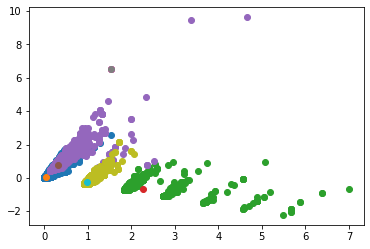

In [228]:
### Perform K-means Clustering on Negative Sentiment
n_doc_topic = perform_clustering(sentiment_type='Negative',num_comps=5)

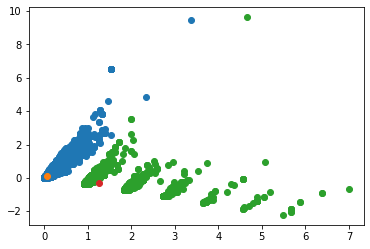

In [229]:
### Perform K-means Clustering on Negative Sentiment
n_doc_topic = perform_clustering(sentiment_type='Negative',num_comps=2)

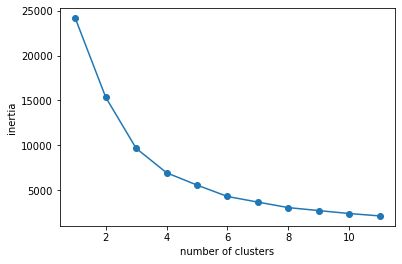

In [230]:
### Elbow on positive
determine_clusters(p_doc_topic,num_comps=11)

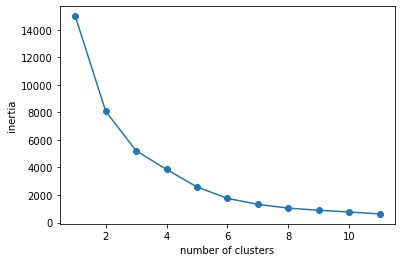

In [231]:
### Elbow on negative
determine_clusters(n_doc_topic,num_comps=11)

In [ ]:
### T-SNE Clustering
tsne_clustering(doc_topic,num_comps=3)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 182032 samples in 16.607s...
[t-SNE] Computed neighbors for 182032 samples in 102.423s...
[t-SNE] Computed conditional probabilities for sample 1000 / 182032
[t-SNE] Computed conditional probabilities for sample 2000 / 182032
[t-SNE] Computed conditional probabilities for sample 3000 / 182032
[t-SNE] Computed conditional probabilities for sample 4000 / 182032
[t-SNE] Computed conditional probabilities for sample 5000 / 182032
[t-SNE] Computed conditional probabilities for sample 6000 / 182032
[t-SNE] Computed conditional probabilities for sample 7000 / 182032
[t-SNE] Computed conditional probabilities for sample 8000 / 182032
[t-SNE] Computed conditional probabilities for sample 9000 / 182032
[t-SNE] Computed conditional probabilities for sample 10000 / 182032
[t-SNE] Computed conditional probabilities for sample 11000 / 182032
[t-SNE] Computed conditional probabilities for sample 12000 / 182032
[t-SNE] Computed conditional prob

[t-SNE] Computed conditional probabilities for sample 122000 / 182032
[t-SNE] Computed conditional probabilities for sample 123000 / 182032
[t-SNE] Computed conditional probabilities for sample 124000 / 182032
[t-SNE] Computed conditional probabilities for sample 125000 / 182032
[t-SNE] Computed conditional probabilities for sample 126000 / 182032
[t-SNE] Computed conditional probabilities for sample 127000 / 182032
[t-SNE] Computed conditional probabilities for sample 128000 / 182032
[t-SNE] Computed conditional probabilities for sample 129000 / 182032
[t-SNE] Computed conditional probabilities for sample 130000 / 182032
[t-SNE] Computed conditional probabilities for sample 131000 / 182032
[t-SNE] Computed conditional probabilities for sample 132000 / 182032
[t-SNE] Computed conditional probabilities for sample 133000 / 182032
[t-SNE] Computed conditional probabilities for sample 134000 / 182032
[t-SNE] Computed conditional probabilities for sample 135000 / 182032
[t-SNE] Computed con

# Term Frequency (TF) for all document

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer

In [ ]:
tf_df = {'Count': []}

vec = CountVectorizer(tokenizer = lambda x: x, lowercase=False, max_df=0.5, min_df=2, max_features=10000)

vec.fit(df_biggest['Tokenized'])

doc_matrix = vec.transform(df_biggest['Tokenized'])

doc_matrix

In [ ]:
tf = np.sum(doc_matrix,axis=0)
tf

In [ ]:
tf.shape

In [ ]:
tf = np.squeeze(np.asarray(tf))

tf

In [ ]:
tf.shape

In [ ]:
tf_df['Count'] = tf

In [ ]:
tf_df

In [ ]:
tf_df = pd.DataFrame(tf_df, index=vec.get_feature_names())

In [ ]:
tf_df.sort_values('Count', ascending=False).head(10)

In [ ]:
tf_df.sort_values('Count', ascending=False).head(20).iplot(kind='bar', 
                                                           color='blue',
                                                           yTitle='Frequency',
                                                           title='Most Frequent Words in The Corpus')

# Term Frequency for each sentement

In [ ]:
df_biggest['Sentiment'].unique()

In [ ]:
tf_df = {}
vec.fit(df_biggest['Tokenized'])

labels = df_biggest['Sentiment'].unique()

for label in labels:
    label_doc_matrix = vec.transform(df_biggest.loc[df_biggest['Sentiment'] == label, 'Tokenized'])
    label_tf = np.sum(label_doc_matrix,axis=0)
    label_tf = np.squeeze(np.asarray(label_tf))
         
    tf_df[label] = label_tf

In [ ]:
tf_df

In [ ]:
tf_df = pd.DataFrame(tf_df, index=vec.get_feature_names())
tf_df['total'] = tf_df.apply(sum, axis=1)

In [ ]:
tf_df.sort_values('Positive', ascending=False).head(20)

In [ ]:
(tf_df.iloc[:, 0:3].sort_values('Negative', ascending=False).head(20)
 .iplot(kind='bar',yTitle='Frequency',
                                                           xTitle='Word Frequency',title='Term Frequency for Each Sentiment'))

In [ ]:
label = 'negative'

'Top 20 Frequent Words in {topic} Reviews'.format(topic=label)

In [ ]:
for label in labels:
    (tf_df.iloc[:, 0:3]
     .sort_values(label, ascending=False)
     .head(20)
     .iplot(mode='lines+markers', size=7, colorscale='set1',
            layout=dict(title='Top 20 Frequent Words in <b><i>{topic}</i></b> Reviews'.format(topic=label),
                        yaxis=dict(title='Frequency'))))

# Bigrams for Each Sentiment

In [ ]:
from nltk.util import ngrams

In [ ]:
def get_ngrams(tokenized_text, n):
        
    n_grams = ngrams(tokenized_text, n)
        
    return [' '.join(grams) for grams in n_grams]

In [ ]:
df_biggest['ngrams'] = df_biggest['Tokenized'].apply(lambda x: get_ngrams(x, 2))

In [ ]:
df_biggest['ngrams'].head(10)

In [ ]:
df_biggest

In [ ]:
df_biggest['Review Length'].max()

In [ ]:
df_biggest['Tokenized']

In [ ]:
tf_df_bi = {}
vec.fit(df_biggest['ngrams'])

labels = df_biggest['Sentiment'].unique()

for label in labels:
    label_doc_matrix = vec.transform(df_biggest.loc[df_biggest['Sentiment'] == label, 'ngrams'])
    label_tf = np.sum(label_doc_matrix,axis=0)
    label_tf = np.squeeze(np.asarray(label_tf))
         
    tf_df_bi[label] = label_tf
                
tf_df_bi = pd.DataFrame(tf_df_bi, index=vec.get_feature_names())
tf_df_bi['total'] = tf_df_bi.apply(sum, axis=1)

In [ ]:
tf_df_bi.sort_values('Positive', ascending=False).head()

In [ ]:
(tf_df_bi.iloc[:, 0:3]
 .sort_values('Positive', ascending=False)
 .head(20)
 .iplot(kind='bar', barmode='stack', colorscale='set1',
        title='Most Frequent Bigrams in Positive Reviews'))

In [ ]:
(tf_df_bi.iloc[:, 0:3]
 .sort_values('Positive', ascending=False)
 .apply(lambda x:x/sum(x),axis=1)
 .head(20)
 .iplot(kind='bar', colorscale='set1',
        title='Most Frequent Bigrams in Positive Reviews'))

In [ ]:
for label in labels:
    (tf_df_bi.iloc[:, 0:3]
     .sort_values(label, ascending=False)
     .apply(lambda x:x/sum(x),axis=1)
     .head(20)
     .iplot(kind='bar', colorscale='set1',
            layout=dict(title='Top 20 Frequent Words in <b><i>{topic}</i></b> Reviews'.format(topic=label),
                        yaxis=dict(title='Bi-gram Frequency'))))

# repeat step for unigram

In [ ]:
df_biggest['ngrams'] = df_biggest['Tokenized'].apply(lambda x: get_ngrams(x, 1))

In [ ]:
df_biggest['ngrams'].head()

In [ ]:
tf_df_bi = {}
vec.fit(df_biggest['ngrams'])

labels = df_biggest['Sentiment'].unique()

for label in labels:
    label_doc_matrix = vec.transform(df_biggest.loc[df_biggest['Sentiment'] == label, 'ngrams'])
    label_tf = np.sum(label_doc_matrix,axis=0)
    label_tf = np.squeeze(np.asarray(label_tf))
         
    tf_df_bi[label] = label_tf
                
tf_df_bi = pd.DataFrame(tf_df_bi, index=vec.get_feature_names())
tf_df_bi['total'] = tf_df_bi.apply(sum, axis=1)

In [ ]:
tf_df_bi.sort_values('Positive', ascending=False).head()

In [ ]:
(tf_df_bi.iloc[:, 0:3]
 .sort_values('Positive', ascending=False)
 .apply(lambda x:x/sum(x),axis=1)
 .head(20)
 .iplot(kind='bar', mode='stack', size=7, colorscale='set2',
        title='Most Frequent Unigrams in Positive Reviews'))

In [ ]:
for label in labels:
    (tf_df_bi.iloc[:, 0:3]
     .sort_values(label, ascending=False)
     .apply(lambda x:x/sum(x),axis=1)
     .head(20)
     .iplot(kind='bar', mode='stack', size=7, colorscale='set2',
            layout=dict(title='Top 20 Frequent Words in <b><i>{topic}</i></b> Reviews'.format(topic=label),
                        yaxis=dict(title='Uni-gram Frequency'))))

# repeat step for trigram

In [ ]:
df_biggest['ngrams'] = df_biggest['Tokenized'].apply(lambda x: get_ngrams(x, 3))

In [ ]:
df_biggest['ngrams'].head()

In [ ]:
tf_df_bi = {}
vec.fit(df_biggest['ngrams'])

labels = df_biggest['Sentiment'].unique()

for label in labels:
    label_doc_matrix = vec.transform(df_biggest.loc[df_biggest['Sentiment'] == label, 'ngrams'])
    label_tf = np.sum(label_doc_matrix,axis=0)
    label_tf = np.squeeze(np.asarray(label_tf))
         
    tf_df_bi[label] = label_tf
                
tf_df_bi = pd.DataFrame(tf_df_bi, index=vec.get_feature_names())
tf_df_bi['total'] = tf_df_bi.apply(sum, axis=1)

In [ ]:
tf_df_bi.sort_values('Positive', ascending=False).head()

In [ ]:
(tf_df_bi.iloc[:, 0:3]
 .sort_values('Positive', ascending=False)
 .apply(lambda x:x/sum(x),axis=1)
 .head(20)
 .iplot(kind='bar', colorscale='set3',
        title='Most Frequent Trigrams in Positive Reviews'))

In [ ]:
for label in labels:
    (tf_df_bi.iloc[:, 0:3]
     .sort_values(label, ascending=False)
     .apply(lambda x:x/sum(x),axis=1)
     .head(20)
     .iplot(kind='bar', colorscale='set3',
            layout=dict(title='Top 20 Frequent Words in <b><i>{topic}</i></b> Reviews'.format(topic=label),
                        yaxis=dict(title='Tri-gram Frequency'))))

In [ ]:
df_biggest.head()

In [ ]:
from sklearn.linear_model import LogisticRegression as lr

# sampling the data

In [ ]:
(df_biggest['Sentiment']
 .value_counts()
 .reset_index()
 .iplot(kind='pie', labels='index', values='Sentiment', hole=0.1, textinfo='label+value+percent',
        colorscale='purples', textcolor='black', title='Sentiment Distribution'))

In [ ]:

#
(df_biggest['Sentiment']
 .value_counts()
 .reset_index()
 .iplot(kind='pie', labels='index', values='Sentiment', hole=0.1, textinfo='label+value+percent',
        colorscale='purd', textcolor='black', title='Sentiment Distribution'))

# make the algorithem with out any kind of  of feature extraction only lower case

In [ ]:
df_biggest['Tokenized'] = [[t.text.lower() for t in review \
                            if not t.is_punct
                            and not t.lemma_ in STOP_WORDS
                            and not t.lemma_ == '-PRON-'] for review in parsed_reviews]

In [ ]:
from sklearn.metrics import log_loss
from sklearn.model_selection import train_test_split


In [ ]:
def train_dev_test_split(X, y, test_size, dev_size, random_state):
    
    X_train, X_dev_test, y_train, y_dev_test = train_test_split(X, y,
                                                                test_size=dev_size+test_size,
                                                                random_state=random_state,
                                                                stratify=y)
    
    
    
    X_dev, X_test, y_dev, y_test = train_test_split(X_dev_test, y_dev_test,
                                                    test_size=0.5,
                                                    random_state=random_state,
                                                    stratify=y_dev_test)
    
    
    
    return X_train, X_dev, X_test, y_train, y_dev, y_test
    

In [ ]:
from sklearn.linear_model import LogisticRegression,SGDClassifier
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_validate, StratifiedKFold, GridSearchCV
from sklearn.metrics import make_scorer, accuracy_score, log_loss, confusion_matrix, classification_report, f1_score, precision_score, recall_score

In [ ]:

X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'].apply(lambda x: " ".join(x)),
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)


scoring = {'Logloss': make_scorer(log_loss, greater_is_better=True, needs_proba=True),
           'Accuracy': make_scorer(accuracy_score),
           'Precision': make_scorer(precision_score, average='weighted'),
           'Recall': make_scorer(recall_score, average='weighted'),
           'F1': make_scorer(f1_score, average='weighted')}

In [ ]:
X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'],
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)

In [ ]:
base_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x), 
    LogisticRegression(n_jobs=-1)   
)

In [ ]:
base_model.fit(X_train, y_train)

In [ ]:
base_model.score(X_train, y_train)

In [ ]:
base_model.score(X_dev, y_dev)

In [ ]:
y_pred = base_model.predict(X_test)
confusion_matrix(y_test, y_pred)

In [ ]:
def pretty_confusion_matrix(model, X_train, y_train, X_test, y_test, classes=['Negaive', 'Neutral', 'Positive']):
    
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    
    confusion_mtx = confusion_matrix(y_test, y_pred)
    
    return pd.DataFrame(confusion_mtx, index=classes, columns=classes)

In [ ]:
pretty_confusion_matrix(base_model, X_train, y_train, X_test, y_test)

In [ ]:
metrics_dict = {'Accuracy': accuracy_score,
                'Precision': precision_score,
                'Recall': recall_score,
                'F1-score': f1_score,
                'Logloss': log_loss}


metrics_dict['Accuracy']

In [ ]:
def train_evaluate(model, features, target, features_dev, target_dev,
                   metrics=['Accuracy', 'Precision', 'Recall', 'F1-score', 'Logloss']):
    
    model.fit(X_train, y_train)
    
    preds_dev = model.predict(X_dev)
    preds_dev_proba = model.predict_proba(X_dev)
    
    preds_train = model.predict(X_train)
    preds_train_proba = model.predict_proba(X_train)
    
    dev_scores = []
    train_scores = []
    
    for metric in metrics:
        if metric == 'Logloss':
            dev_scores.append(log_loss(target_dev, preds_dev_proba))
            train_scores.append(log_loss(target, preds_train_proba))
        
        elif metric == 'Accuracy':
            dev_scores.append(metrics_dict[metric](target_dev, preds_dev))
            train_scores.append(metrics_dict[metric](target, preds_train))
            
        else:
            dev_scores.append(metrics_dict[metric](target_dev, preds_dev, average='weighted'))
            train_scores.append(metrics_dict[metric](target, preds_train, average='weighted'))
            
    scores_df = pd.DataFrame([train_scores, dev_scores], columns=metrics, index=['Train', 'Development'])
            
    return scores_df
        

In [ ]:
base_model_res = train_evaluate(base_model, X_train, y_train, X_dev, y_dev)

In [ ]:
base_model_res

# remove noize feature

In [ ]:
noise_removed_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x, max_df=0.5, min_df=4), 
    LogisticRegression()   
)

In [ ]:
noise_removed_model = train_evaluate(noise_removed_model, X_train, y_train, X_dev, y_dev)

In [ ]:
noise_removed_model

# By addition
N-gram

In [ ]:
bigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    LogisticRegression()   
)

In [ ]:
bigram_model_res = train_evaluate(bigram_model, X_train, y_train, X_dev, y_dev)

In [ ]:
bigram_model_res

# Trigram

In [ ]:
trigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    LogisticRegression()   
)

In [ ]:
trigram_model_res = train_evaluate(trigram_model, X_train, y_train, X_dev, y_dev)

In [ ]:
trigram_model_res

In [ ]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer

# TFIDF

In [ ]:
# unigram
tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4), 
    TfidfTransformer(),
    LogisticRegression()   
)

In [ ]:
tfidf_res = train_evaluate(tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
tfidf_res

In [ ]:
# bigram
bigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    TfidfTransformer(),
    LogisticRegression()   
)

In [ ]:
bigram_tfidf_res = train_evaluate(bigram_tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
bigram_tfidf_res

# Trigram

In [ ]:
# trigram
trigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    TfidfTransformer(),
    LogisticRegression()   
)

In [ ]:
trigram_tfidf_res = train_evaluate(trigram_tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
trigram_tfidf_res

# SGB classifier :

In [ ]:
base_model2 = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x), 
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1) 
)

In [ ]:
base_model2.fit(X_train, y_train)

In [ ]:
base_model2.score(X_train, y_train)

In [ ]:
base_model2.score(X_dev, y_dev)

In [ ]:
y_pred = base_model2.predict(X_test)
confusion_matrix(y_test, y_pred)

In [ ]:
pretty_confusion_matrix(base_model2, X_train, y_train, X_test, y_test)

In [ ]:
def train_evaluate(model, features, target, features_dev, target_dev,
                   metrics=['Accuracy', 'Precision', 'Recall', 'F1-score']):
    
    model.fit(X_train, y_train)
    
    preds_dev = model.predict(X_dev)
#     preds_dev_proba = model.predict_proba(X_dev)
    
    preds_train = model.predict(X_train)
#     preds_train_proba = model.predict_proba(X_train)
    
    dev_scores = []
    train_scores = []
    
    for metric in metrics:
#         if metric == 'Logloss':
#             dev_scores.append(log_loss(target_dev, preds_dev_proba))
#             train_scores.append(log_loss(target, preds_train_proba))
        
        if metric == 'Accuracy':
            dev_scores.append(metrics_dict[metric](target_dev, preds_dev))
            train_scores.append(metrics_dict[metric](target, preds_train))
            
        else:
            dev_scores.append(metrics_dict[metric](target_dev, preds_dev, average='weighted'))
            train_scores.append(metrics_dict[metric](target, preds_train, average='weighted'))
            
    scores_df = pd.DataFrame([train_scores, dev_scores], columns=metrics, index=['Train', 'Development'])
            
    return scores_df

In [ ]:
base_model_res = train_evaluate(base_model2, X_train, y_train, X_dev, y_dev)
base_model_res

# Feature Engineering
By Reduction

In [ ]:
df_biggest['Tokenized'] = [[t.lemma_ for t in review \
                            if not t.is_punct
                            and not t.lemma_ in STOP_WORDS
                            and not t.lemma_ == '-PRON-'] for review in parsed_reviews]

X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'],
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)

In [ ]:
lemmatized_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x), 
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)
)

lemmatized_model_res = train_evaluate(lemmatized_model, X_train, y_train, X_dev, y_dev)

lemmatized_model_res

# Remove Noisy Features

In [ ]:
noise_removed_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x, max_df=0.5, min_df=4), 
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)
)  

# noise_removed_model_res = evaluate_model(noise_removed_model, features=X_train, target=y_train)
noise_removed_model_res = train_evaluate(noise_removed_model, X_train, y_train, X_dev, y_dev)
noise_removed_model_res

# By Addition
N-grams

In [ ]:
bigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)
)
bigram_model_res = train_evaluate(bigram_model, X_train, y_train, X_dev, y_dev)
bigram_model_res

In [ ]:
trigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)   
)
# trigram_model_res = evaluate_model(trigram_model, features=X_train, target=y_train)
trigram_model_res = train_evaluate(trigram_model, X_train, y_train, X_dev, y_dev)
trigram_model_res

# TF-IDF

In [ ]:
# unigram
tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4), 
    TfidfTransformer(),
   SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)
)

tfidf_res = train_evaluate(tfidf, X_train, y_train, X_dev, y_dev)

tfidf_res

In [ ]:
# bigram
bigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    TfidfTransformer(),
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1)
)

In [ ]:
bigram_tfidf_res = train_evaluate(bigram_tfidf, X_train, y_train, X_dev, y_dev)
bigram_tfidf_res

In [ ]:
# trigram
trigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    TfidfTransformer(),
    SGDClassifier(max_iter=100, early_stopping=True, random_state=10, n_jobs=-1) 
)
trigram_tfidf_res = train_evaluate(trigram_tfidf, X_train, y_train, X_dev, y_dev)
trigram_tfidf_res

In [ ]:
X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'],
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)

In [ ]:
from sklearn.naive_bayes import MultinomialNB

## using naive_bayes

In [ ]:
X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'],
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)

In [ ]:
base_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x), 
    MultinomialNB()   
)

In [ ]:
base_model.fit(X_train, y_train)

In [ ]:
base_model.score(X_train, y_train)

In [ ]:
base_model.score(X_dev, y_dev)

In [ ]:
y_pred = base_model.predict(X_test)
confusion_matrix(y_test, y_pred)

In [ ]:
def pretty_confusion_matrix(model, X_train, y_train, X_test, y_test, classes=['Negaive', 'Neutral', 'Positive']):
    
    model.fit(X_train, y_train)
    
    y_pred = model.predict(X_test)
    
    confusion_mtx = confusion_matrix(y_test, y_pred)
    
    return pd.DataFrame(confusion_mtx, index=classes, columns=classes)

In [ ]:
pretty_confusion_matrix(base_model, X_train, y_train, X_test, y_test)

In [ ]:
metrics_dict = {'Accuracy': accuracy_score,
                'Precision': precision_score,
                'Recall': recall_score,
                'F1-score': f1_score,
                'Logloss': log_loss}


metrics_dict['Accuracy']

In [ ]:
base_model_res = train_evaluate(base_model, X_train, y_train, X_dev, y_dev)

In [ ]:
base_model_res

## Feature Engineering

### By Reduction

In [ ]:
df_biggest['Tokenized'] = [[t.lemma_ for t in review \
                            if not t.is_punct
                            and not t.lemma_ in STOP_WORDS
                            and not t.lemma_ == '-PRON-'] for review in parsed_reviews]

In [ ]:
X_train, X_dev, X_test, y_train, y_dev, y_test = train_dev_test_split(df_biggest['Tokenized'],
                                                                      df_biggest['Sentiment'],
                                                                      test_size=0.15,
                                                                      dev_size=0.15,
                                                                      random_state=10)

In [ ]:
lemmatized_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x), 
    MultinomialNB()  
)

In [ ]:
lemmatized_model_res = train_evaluate(lemmatized_model, X_train, y_train, X_dev, y_dev)

In [ ]:
lemmatized_model_res

#### Remove Noisy Features

In [ ]:
noise_removed_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer= lambda x: x, max_df=0.5, min_df=4), 
    MultinomialNB() 
)

In [ ]:
noise_removed_model_res = train_evaluate(noise_removed_model, X_train, y_train, X_dev, y_dev)

In [ ]:
noise_removed_model_res

### By Addition

- N-grams

In [ ]:
bigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    MultinomialNB()  
)

In [ ]:
bigram_model_res = train_evaluate(bigram_model, X_train, y_train, X_dev, y_dev)

In [ ]:
bigram_model_res

In [ ]:
trigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    MultinomialNB()   
)

In [ ]:
trigram_model_res = train_evaluate(trigram_model, X_train, y_train, X_dev, y_dev)

In [ ]:
trigram_model_res

### TF-IDF

In [ ]:
tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4), 
    TfidfTransformer(),
    MultinomialNB()   
)

In [ ]:
tfidf_res = train_evaluate(tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
tfidf_res

In [ ]:
# bigram
bigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,2)), 
    TfidfTransformer(),
    MultinomialNB()   
)

In [ ]:
bigram_tfidf_res = train_evaluate(bigram_tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
bigram_tfidf_res

In [ ]:
# trigram
trigram_tfidf = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)), 
    TfidfTransformer(),
    MultinomialNB()   
)

In [ ]:
trigram_tfidf_res = train_evaluate(trigram_tfidf, X_train, y_train, X_dev, y_dev)

In [ ]:
trigram_tfidf_res

In [ ]:

trigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)),
    LogisticRegression()
)

In [ ]:

trigram_model = make_pipeline(
    CountVectorizer(lowercase=False, tokenizer=lambda x: x, max_df=0.5, min_df=4, ngram_range=(1,3)),
    LogisticRegression()
)

In [ ]:
trigram_model.fit(X_tr, y_tr)

In [ ]:
trigram_model.score(X_tr, y_tr)


In [ ]:
y_pred = trigram_model.predict(X_test)


In [ ]:
print(f'Accuracy: {accuracy_score(y_test, y_pred)}\n')


In [ ]:
lo_matrix=confusion_matrix(y_test, y_pred)


In [ ]:
lo_matrix


In [ ]:
import seaborn as sns
sns.heatmap(lo_matrix,annot=True, cmap='Blues')
plt.title('Confusion matrix for logistic regressor on test data')